In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import matplotlib.dates as mdates
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [2]:
PATH = '/workspaces/machine-learning-python-template-ds-Julio/data/raw/'

aquifer_auser=pd.read_csv(f'{PATH}Aquifer_Auser.csv')
aquifer_doganella=pd.read_csv(f'{PATH}Aquifer_Doganella.csv')
aquifer_luco=pd.read_csv(f'{PATH}Aquifer_Luco.csv')
aquifer_petrignano=pd.read_csv(f'{PATH}Aquifer_Petrignano.csv')
Lake_Bilancino=pd.read_csv(f'{PATH}Lake_Bilancino.csv')
river_arno=pd.read_csv(f'{PATH}River_Arno.csv')
water_spring_amiata=pd.read_csv(f'{PATH}Water_Spring_Amiata.csv')
water_spring_Lupa=pd.read_csv(f'{PATH}Water_Spring_Lupa.csv')
water_spring_madonna_di_canneto=pd.read_csv(f'{PATH}Water_Spring_Madonna_di_Canneto.csv')





In [3]:
ds = [aquifer_auser, aquifer_doganella, aquifer_luco, aquifer_petrignano, Lake_Bilancino, river_arno, water_spring_amiata, water_spring_Lupa, water_spring_madonna_di_canneto]

ds_names=['aquifer_auser', 'aquifer_doganella', 'aquifer_luco', 'aquifer_petrignano', 'lake_bilancino', 'river_arno', 'water_spring_amiata', 'water_spring_Lupa', 'water_spring_madonna_di_canneto']
for dataset in ds:
    print(dataset.shape)


(8154, 27)
(6026, 22)
(7487, 22)
(5223, 8)
(6603, 9)
(8217, 17)
(7487, 16)
(4199, 3)
(3113, 4)


In [4]:
for dataset in ds:
    print(dataset.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8154 entries, 0 to 8153
Data columns (total 27 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Date                                     8154 non-null   object 
 1   Rainfall_Gallicano                       5295 non-null   float64
 2   Rainfall_Pontetetto                      5295 non-null   float64
 3   Rainfall_Monte_Serra                     5289 non-null   float64
 4   Rainfall_Orentano                        5295 non-null   float64
 5   Rainfall_Borgo_a_Mozzano                 5295 non-null   float64
 6   Rainfall_Piaggione                       4930 non-null   float64
 7   Rainfall_Calavorno                       5295 non-null   float64
 8   Rainfall_Croce_Arcana                    5295 non-null   float64
 9   Rainfall_Tereglio_Coreglia_Antelminelli  5295 non-null   float64
 10  Rainfall_Fabbriche_di_Vallico            5295 no

In [5]:
def bar_plot(x, y, title, palette_len, xlim = None, ylim = None, 
             xticklabels = None, yticklabels = None, 
             top_visible = False, right_visible = False, 
             bottom_visible = True, left_visible = False,
             xlabel = None, ylabel = None, figsize = (10, 4),
             axis_grid = 'y'):
    fig, ax = plt.subplots(figsize = figsize)
    plt.title(title, size = 15, fontweight = 'bold', fontfamily = 'monospace')

    for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_color('black')
    
    ax.spines['top'].set_visible(top_visible)
    ax.spines['right'].set_visible(right_visible)
    ax.spines['bottom'].set_visible(bottom_visible)
    ax.spines['left'].set_visible(left_visible)

    sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
                palette = reversed(sns.color_palette("viridis", len(palette_len))))
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)    
    ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
    ax.set_yticklabels(yticklabels, fontfamily = 'monospace')
    plt.xlabel(xlabel, fontfamily = 'monospace')
    plt.ylabel(ylabel, fontfamily = 'monospace')
    ax.grid(axis = axis_grid, linestyle = '--', alpha = 0.9)
    plt.show()

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


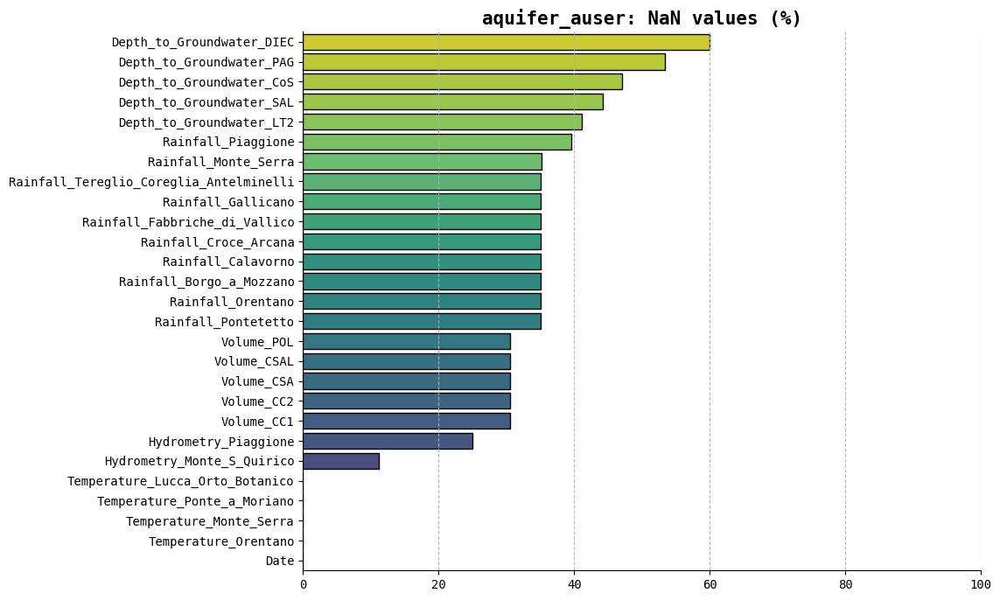

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


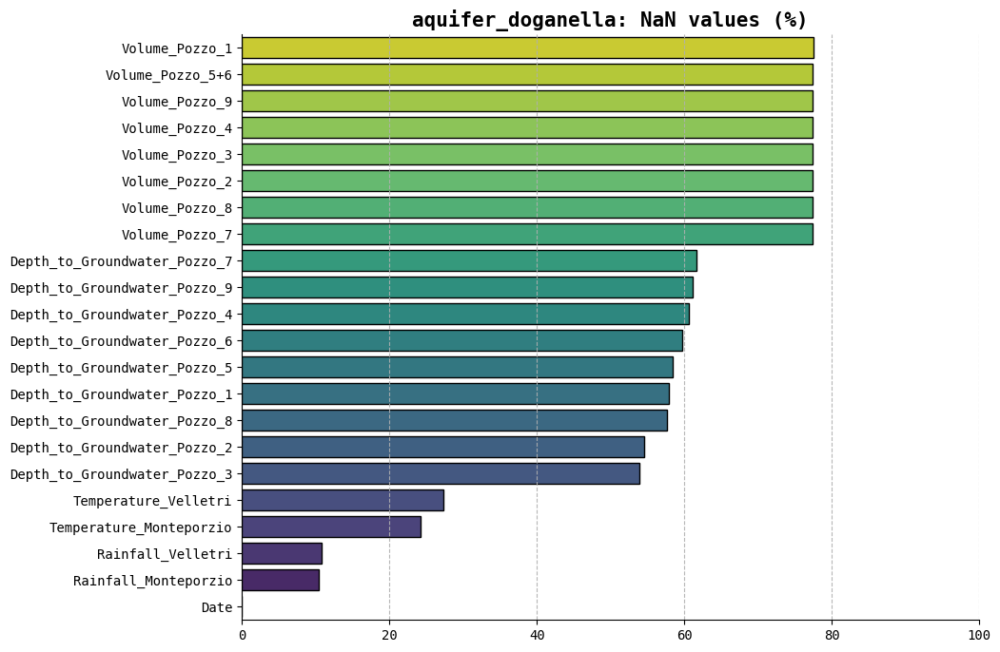

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


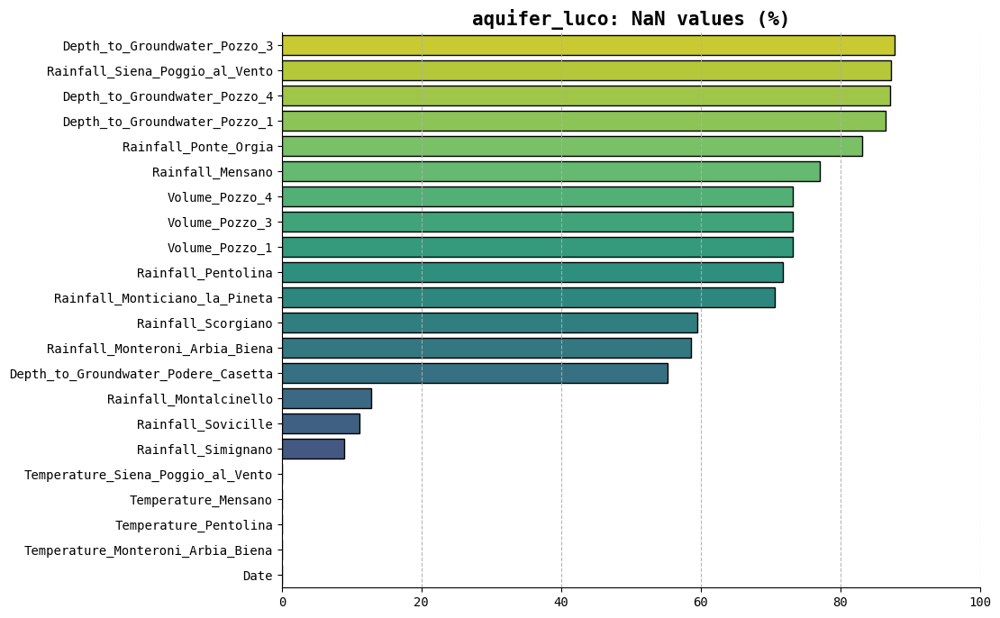

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


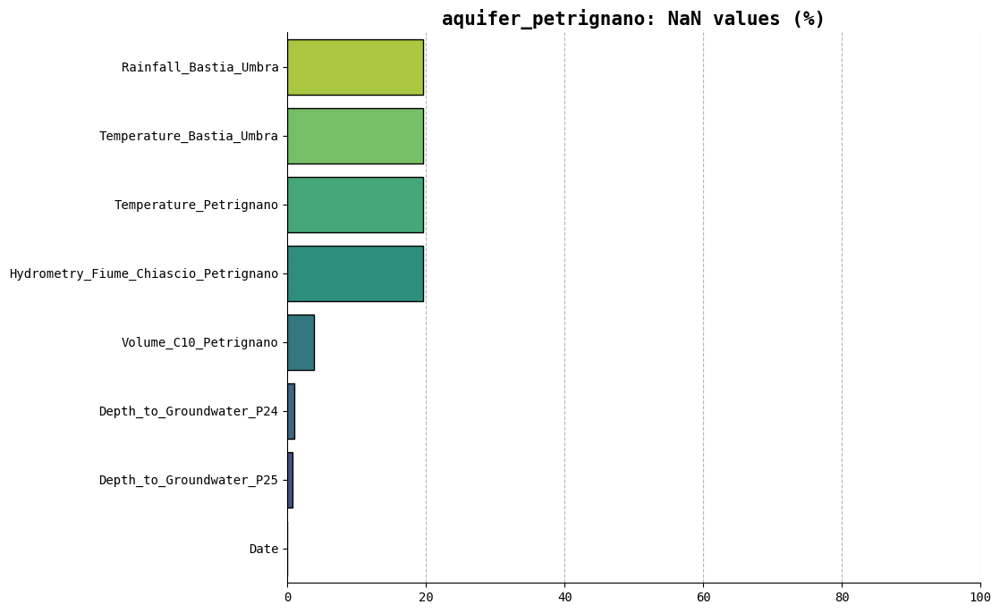

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


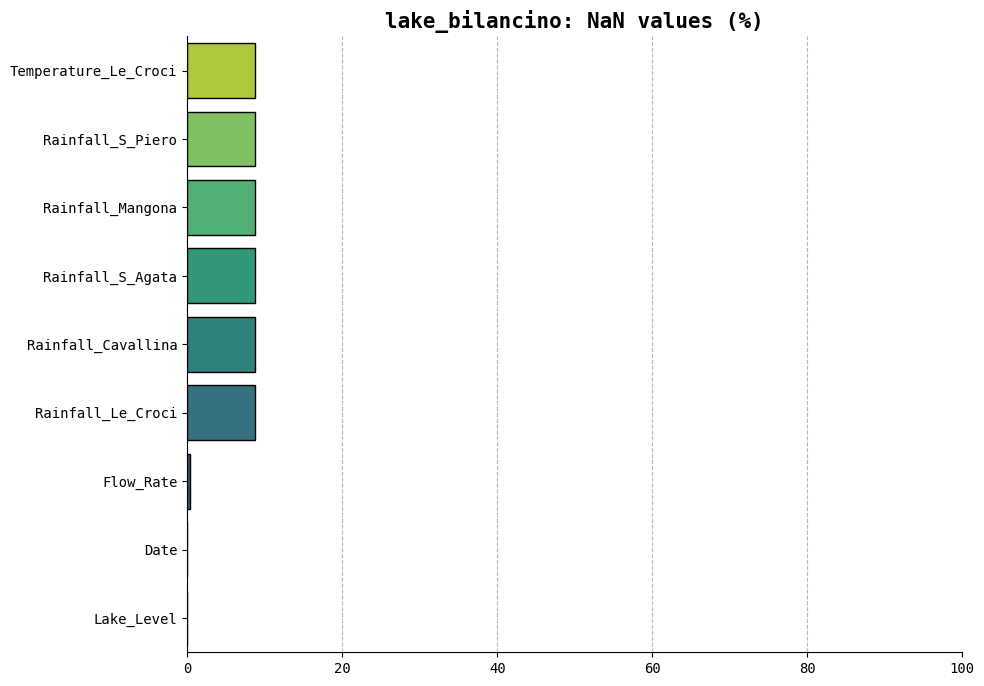

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


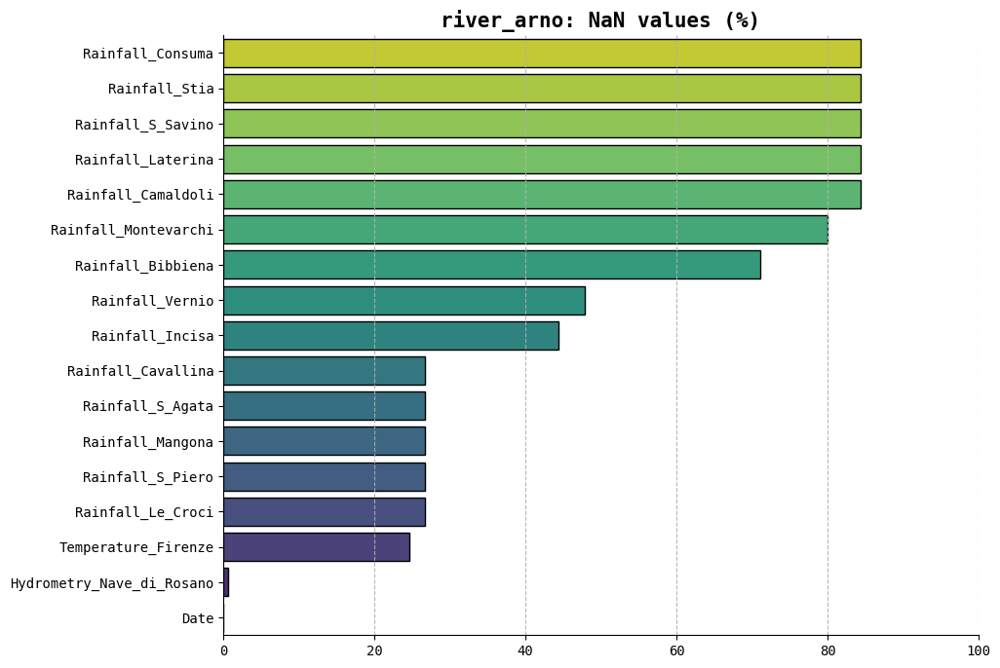

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


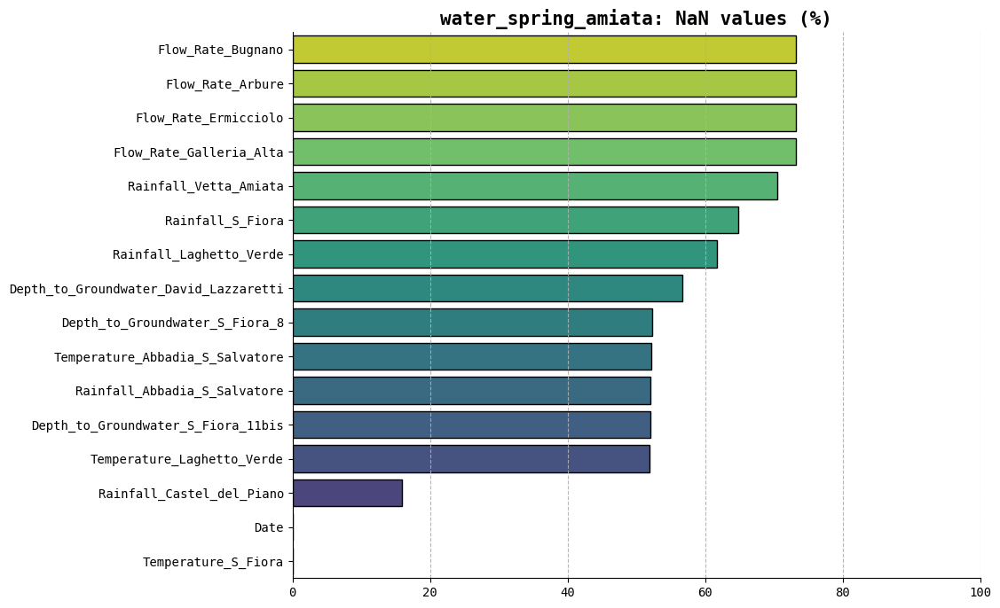

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


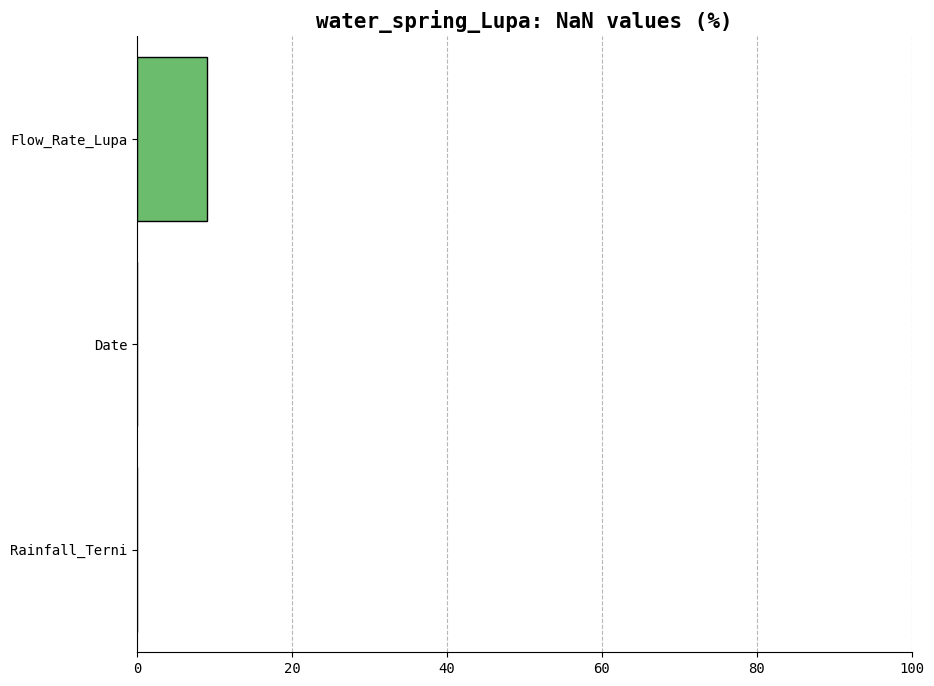

/tmp/ipykernel_569/2205703255.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
/tmp/ipykernel_569/2205703255.py:22: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(xticklabels, fontfamily = 'monospace')
/tmp/ipykernel_569/2205703255.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(yticklabels, fontfamily = 'monospace')


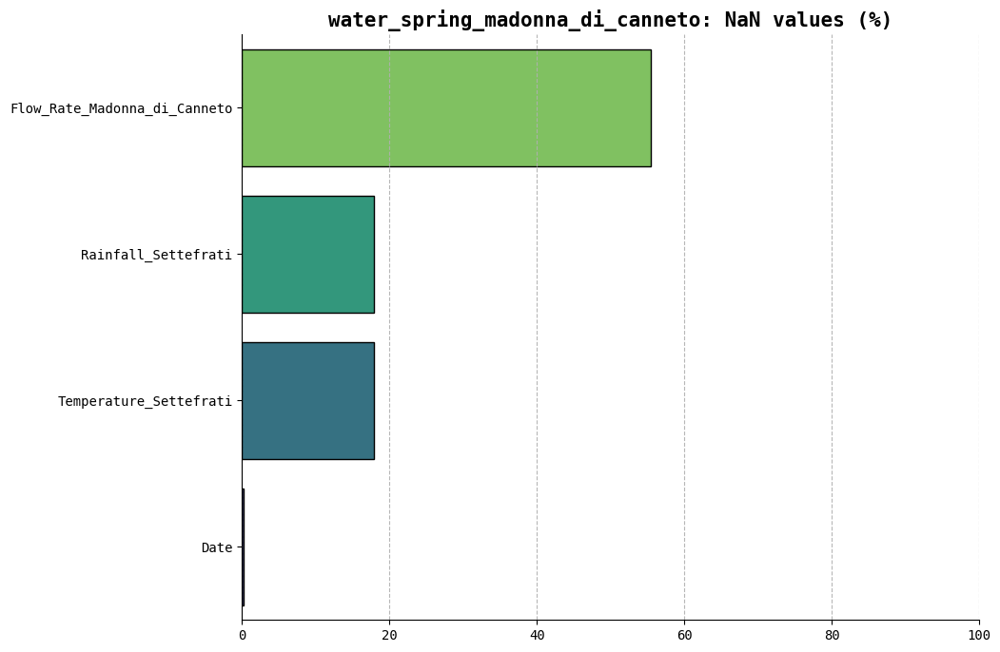

In [6]:
for i in range(len(ds)):
    NaN_values = (ds[i].isnull().sum() / len(ds[i]) * 100).sort_values(ascending = False)
    bar_plot(x = NaN_values, 
             y = NaN_values.index,
             title = '{}: NaN values (%)'.format(ds_names[i]),
             palette_len = NaN_values.index, 
             xlim = (0, 100), 
             xticklabels = range(0, 101, 20),
             yticklabels = NaN_values.index,
             left_visible = True,
             figsize = (10, 8), axis_grid = 'x')

In [7]:
for dataset in ds :
    print(dataset.describe())

       Rainfall_Gallicano  Rainfall_Pontetetto  Rainfall_Monte_Serra  \
count         5295.000000          5295.000000           5289.000000   
mean             4.948782             3.495449              3.919077   
std             14.366480             9.983772             10.815270   
min              0.000000             0.000000              0.000000   
25%              0.000000             0.000000              0.000000   
50%              0.000000             0.000000              0.000000   
75%              2.000000             1.000000              1.600000   
max            318.800000           146.600000            152.200000   

       Rainfall_Orentano  Rainfall_Borgo_a_Mozzano  Rainfall_Piaggione  \
count        5295.000000               5295.000000         4930.000000   
mean            3.150670                  4.578961            3.953976   
std             8.747507                 12.771166           10.888103   
min             0.000000                  0.000000     

In [8]:
def line_plot(data, y , title,color,
              top_visble=False, right_visble= False,
              bottom_visble=True , left_visble=False,
              ylabel=None, figsize=(10,4), axis_grid='y'):
    fig, ax= plt.subplots(figsize=figsize)
    plt.title(title,size=15,fontweight='bold', fontfamily='monospace')

    for i in ['top','right','bottom', 'left']:
        ax.spines['top'].set_visible(top_visble)
        ax.spines['right'].set_visible(top_visble)
        ax.spines['bottom'].set_visible(bottom_visble)
        ax.spines['left'].set_visible(left_visble)

        sns.lineplot(x= range(len(data[y])), y=data[y],dashes=False,
                     color=color,linewidth=.5)
        ax.xaxis.set_major_locator(plt.MaxNLocator(20))

        ax.set_xticks([])
        plt.xticks(rotation=90)
        plt.xlabel('')
        plt.ylabel(ylabel,fontfamily='monospace')
        plt.grid(axis_grid, linestyle='--', alpha=0.9)
        plt.show()

def corr_plot(data,
              top_visble=False,right_visble=False,
              bottom_visble=True, left_visble=False,
              ylabel=None,figsize=(15,11), axis_grid='y'):
    fig, ax= plt.subplots(figsize=figsize)
    plt.title('correlatiuons(pearson)',size= 15, fontweight='bold',fontfamily='monospace')
    mask =np.triu(np.ones_like(data.corr(),dtype= bool))
    sns.heatmap(round(data.corr(),2),mask=mask,cmap='viridis',annot=True)
    plt.show()


def columns_viz(data,color):
    for i in range(len(data.columns)):
        line_plot(data=data, y =data.columns[i],
                  color=color,
                  title='{}dynamics'.format(data.columns[i]),
                  bottom_visble= False, figsize=(10,2))



In [9]:
def predicted_viz(y_test , y_pred, param, name , original_df):
    y_test_values = y_test.values.flatten()
    y_pred_values=y_pred.flatten()

    dates=original_df.loc[y_test.index,'Date']

    assert len(dates)== len(y_test_values)== len(y_pred_values),"THE length of mismatching dates and predictions"
    
    rm=pd.DataFrame({param: y_test_values, 'Date':dates})
    rm['month_year']=pd.to_datetime(rm['Date']).dt.to_period('M')
    rm_means=rm.groupby('month_year')[param].mean().reset_index()
    rm_means['month_year']=rm_means['month_year'].dt.to_timestamp()

    pm= pd.DataFrame({param: y_pred_values,'Date':dates})
    pm['month_year']=pd.to_datetime(rm['Date']).dt.to_period('M')
    pm_means=pm.groupby('month_year')[param].mean().reset_index()
    pm_means['month_year']=pm_means['month_year'].dt.to_timestamp()

    fig, ax = plt.subplots(figsize=(15, 5))
    plt.title(f'{param} prediction ({name})', size=15, fontweight='bold', fontfamily='serif')

    sns.lineplot(data=rm_means, x='month_year', y=param, color='green', label=f'Real {param}')
    sns.lineplot(data=pm_means, x='month_year', y=param, color='pink', label=f'Pred {param}')

    for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_visible(False)

    ax.set_xticks(rm_means['month_year'].dt.strftime('%Y-%m')[::12])
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.grid(axis='y', linestyle='--', alpha=0.9)
    plt.show()

    
    


In [10]:
ds[0].head()

,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
0,05/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,06/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,10.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,07/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.2,0.0,10.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,08/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,13.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,09/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,12.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN


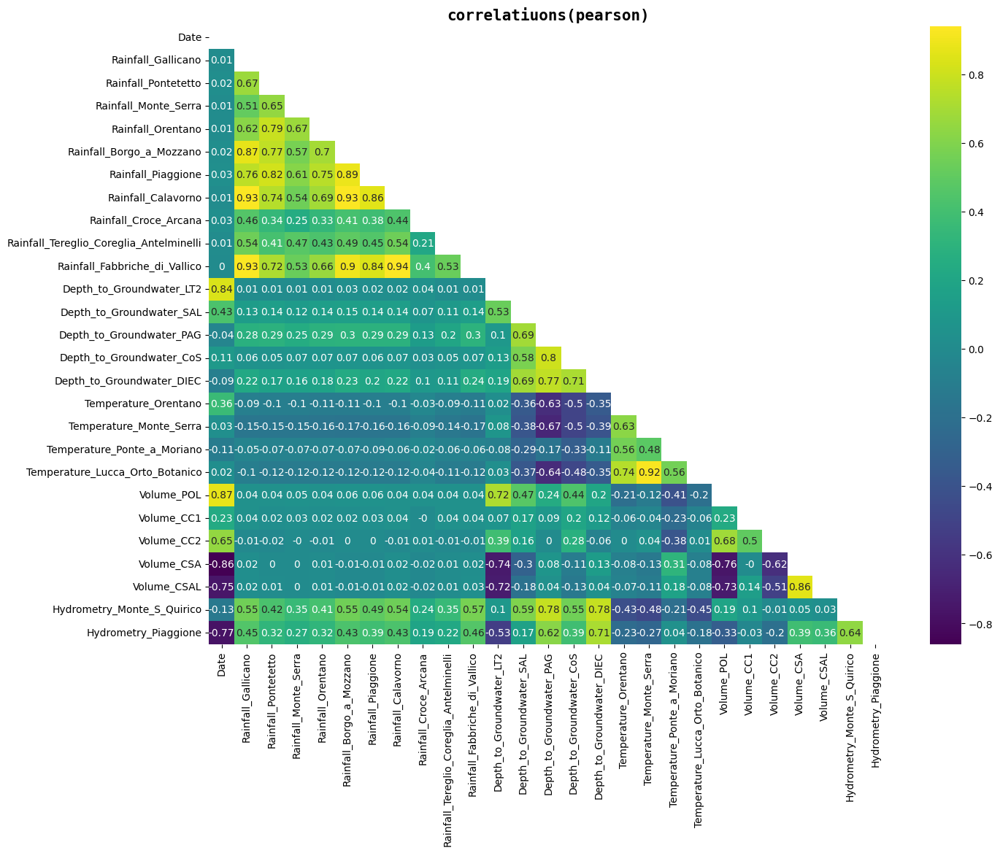

In [11]:
ds[0]['Date']=pd.to_datetime(ds[0]['Date'],dayfirst=True)

corr_plot(ds[0],'aquifer_auser',(20,20))

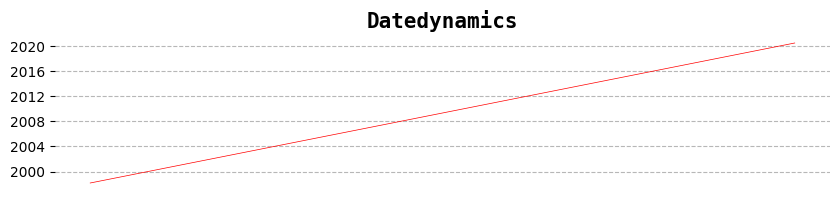

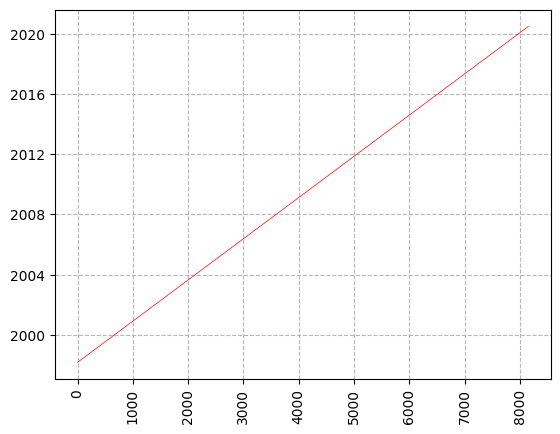

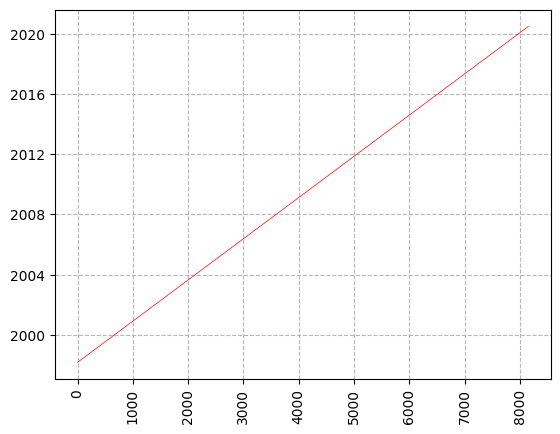

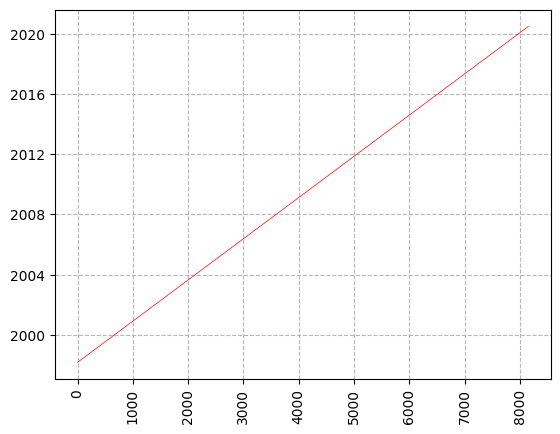

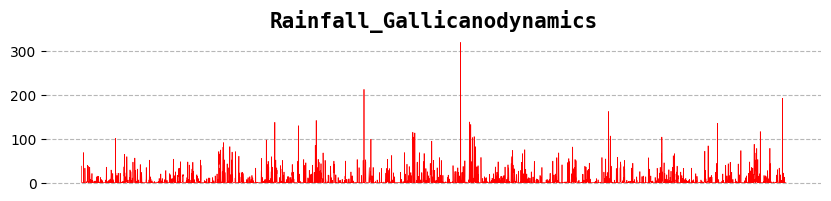

...

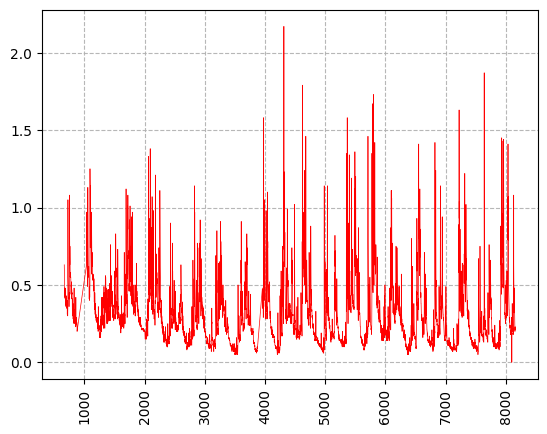

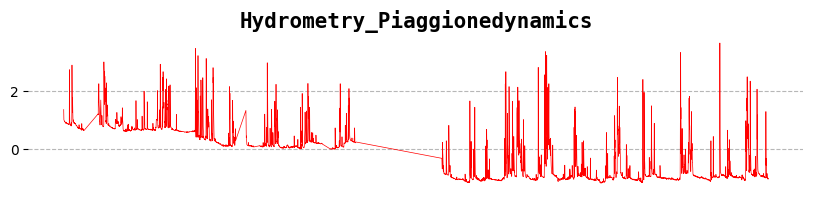

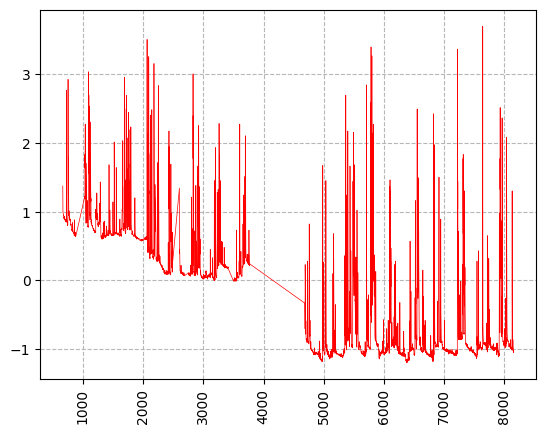

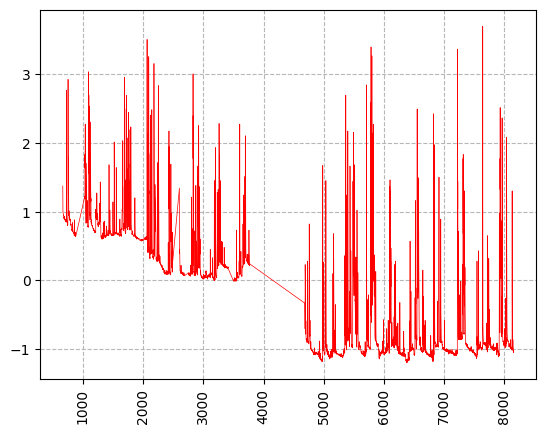

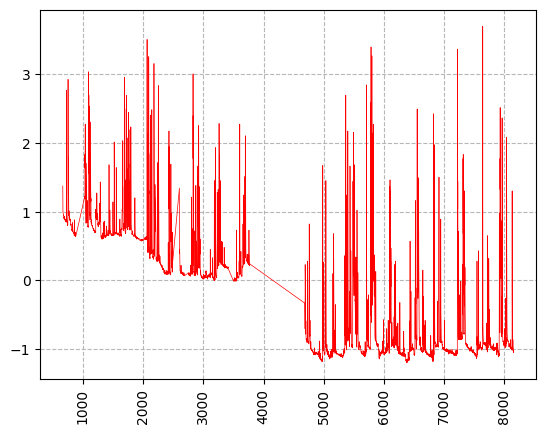

In [12]:
columns_viz(ds[0],color='red')

In [13]:
ds[0].columns

Index(['Date', 'Rainfall_Gallicano', 'Rainfall_Pontetetto',
       'Rainfall_Monte_Serra', 'Rainfall_Orentano', 'Rainfall_Borgo_a_Mozzano',
       'Rainfall_Piaggione', 'Rainfall_Calavorno', 'Rainfall_Croce_Arcana',
       'Rainfall_Tereglio_Coreglia_Antelminelli',
       'Rainfall_Fabbriche_di_Vallico', 'Depth_to_Groundwater_LT2',
       'Depth_to_Groundwater_SAL', 'Depth_to_Groundwater_PAG',
       'Depth_to_Groundwater_CoS', 'Depth_to_Groundwater_DIEC',
       'Temperature_Orentano', 'Temperature_Monte_Serra',
       'Temperature_Ponte_a_Moriano', 'Temperature_Lucca_Orto_Botanico',
       'Volume_POL', 'Volume_CC1', 'Volume_CC2', 'Volume_CSA', 'Volume_CSAL',
       'Hydrometry_Monte_S_Quirico', 'Hydrometry_Piaggione'],
      dtype='object')

In [14]:
auser_pred = aquifer_auser
rainfall_auser = [col for col in auser_pred.columns if 'Rainfall' in col]
temperature_auser = [col for col in auser_pred.columns if 'Temperature' in col]
volume_auser = [col for col in auser_pred.columns if 'Volume' in col]
hydrometry_auser = [col for col in auser_pred.columns if 'Hydrometry' in col]

auser_pred['rainfall_mean'] = auser_pred[rainfall_auser].mean(axis = 1).values
auser_pred['temperature_mean'] = auser_pred[temperature_auser].mean(axis = 1).values
auser_pred['volume_mean'] = auser_pred[volume_auser].mean(axis = 1).values
auser_pred['hydrometry_mean'] = auser_pred[hydrometry_auser].mean(axis = 1).values
Auser_pred = auser_pred.drop(['Depth_to_Groundwater_PAG', 'Depth_to_Groundwater_DIEC',
                        'Temperature_Ponte_a_Moriano', 'Temperature_Orentano',
                        'Volume_CSA', 'Volume_CSAL'], axis = 1)
Auser_pred = Auser_pred.fillna(method = 'bfill')

Auser_pred.dtypes

/tmp/ipykernel_569/3497669274.py:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  Auser_pred = Auser_pred.fillna(method = 'bfill')


Date                                       datetime64[ns]
Rainfall_Gallicano                                float64
Rainfall_Pontetetto                               float64
Rainfall_Monte_Serra                              float64
Rainfall_Orentano                                 float64
Rainfall_Borgo_a_Mozzano                          float64
Rainfall_Piaggione                                float64
Rainfall_Calavorno                                float64
Rainfall_Croce_Arcana                             float64
Rainfall_Tereglio_Coreglia_Antelminelli           float64
Rainfall_Fabbriche_di_Vallico                     float64
Depth_to_Groundwater_LT2                          float64
Depth_to_Groundwater_SAL                          float64
Depth_to_Groundwater_CoS                          float64
Temperature_Monte_Serra                           float64
Temperature_Lucca_Orto_Botanico                   float64
Volume_POL                                        float64
Volume_CC1    

In [15]:
y0 = Auser_pred[['Depth_to_Groundwater_LT2', 'Depth_to_Groundwater_SAL', 'Depth_to_Groundwater_CoS']]
x0 = Auser_pred.drop(['Depth_to_Groundwater_LT2', 'Depth_to_Groundwater_SAL', 'Depth_to_Groundwater_CoS'], axis = 1)

x_train_auser, x_test_auser, y_train_auser, y_test_auser = train_test_split(x0, y0, test_size = 0.2, random_state = 42, shuffle = False)


In [16]:
auser_model_LT2 = XGBRegressor(n_estimators = 1000, learning_rate = 0.01, random_state = 42, enable_categorical=True)
auser_model_SAL = XGBRegressor(n_estimators = 1000, learning_rate = 0.01, random_state = 42, enable_categorical=True)
auser_model_CoS = XGBRegressor(n_estimators = 1000, learning_rate = 0.01, random_state = 42, enable_categorical=True)

x_train_auser['Date'] = pd.to_datetime(x_train_auser['Date'])
x_test_auser['Date'] = pd.to_datetime(x_test_auser['Date'])

x_train_auser['Year'] = x_train_auser['Date'].dt.year
x_train_auser['Month'] = x_train_auser['Date'].dt.month
x_train_auser['Day'] = x_train_auser['Date'].dt.day

x_test_auser['Year'] = x_test_auser['Date'].dt.year
x_test_auser['Month'] = x_test_auser['Date'].dt.month
x_test_auser['Day'] = x_test_auser['Date'].dt.day

x_train_auser = x_train_auser.drop('Date', axis=1)
x_test_auser = x_test_auser.drop('Date', axis=1)

auser_model_LT2.fit(x_train_auser, y_train_auser['Depth_to_Groundwater_LT2'])
auser_model_SAL.fit(x_train_auser, y_train_auser['Depth_to_Groundwater_SAL'])
auser_model_CoS.fit(x_train_auser, y_train_auser['Depth_to_Groundwater_CoS'])

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=True, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [17]:
auser_y_pred_LT2= auser_model_LT2.predict(x_test_auser)
auser_y_pred_SAl=auser_model_SAL.predict(x_test_auser)
auser_y_pred_CoS= auser_model_CoS.predict(x_test_auser)

print('MaE LT2:', mean_absolute_error(y_test_auser['Depth_to_Groundwater_LT2'],auser_y_pred_LT2))
print('MaE SAL:', mean_absolute_error(y_test_auser['Depth_to_Groundwater_SAL'],auser_y_pred_SAl))
print('MaE LT2:', mean_absolute_error(y_test_auser['Depth_to_Groundwater_LT2'],auser_y_pred_CoS))

MaE LT2: 0.3414810354442117
MaE SAL: 0.26259795010564957
MaE LT2: 6.074564547407196


In [18]:
y_test_auser.columns

Index(['Depth_to_Groundwater_LT2', 'Depth_to_Groundwater_SAL',
       'Depth_to_Groundwater_CoS'],
      dtype='object')

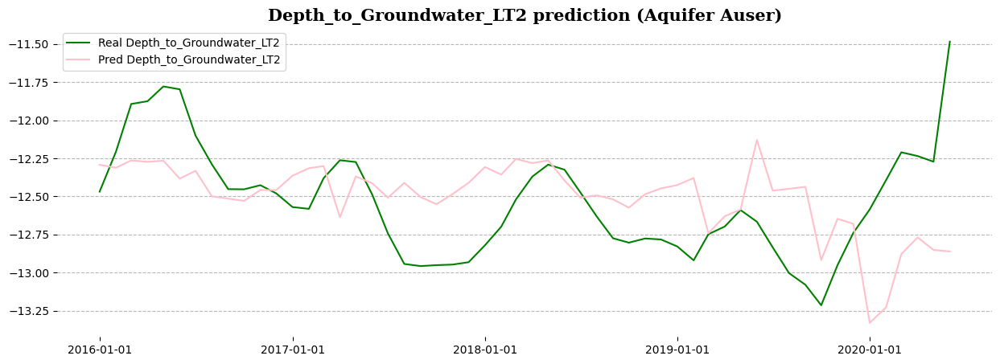

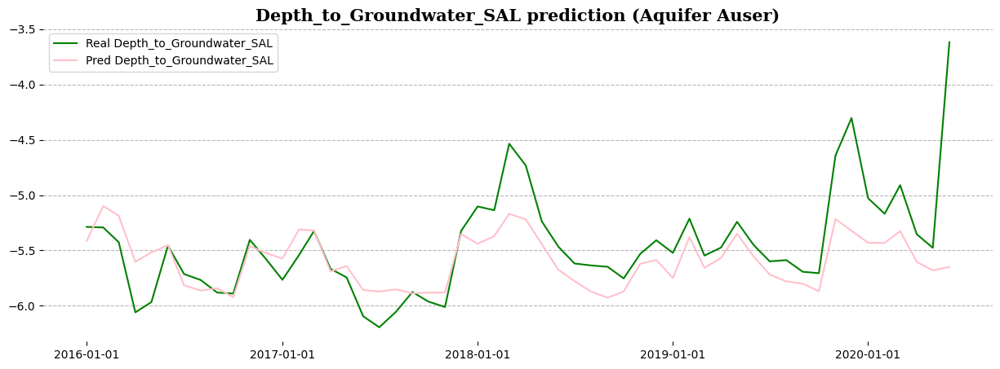

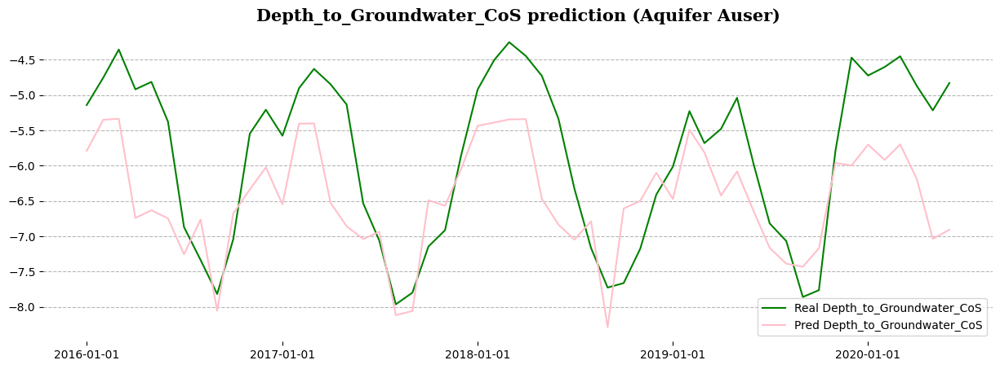

In [19]:
predicted_viz(y_test_auser.iloc[:, 0], auser_y_pred_LT2, 'Depth_to_Groundwater_LT2', 'Aquifer Auser', aquifer_auser)
predicted_viz(y_test_auser.iloc[:, 1], auser_y_pred_SAl, 'Depth_to_Groundwater_SAL', 'Aquifer Auser', aquifer_auser)
predicted_viz(y_test_auser.iloc[:, 2], auser_y_pred_CoS, 'Depth_to_Groundwater_CoS', 'Aquifer Auser', aquifer_auser)


Aquifer Doganella

In [20]:
ds[1].head()

,Date,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
0,01/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.30,8.60
1,02/01/2004,0.2,0.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.70,6.25
2,03/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.40,9.80
3,04/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.35,5.95
4,05/01/2004,0.2,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.60,5.85


In [21]:
ds[1].columns

Index(['Date', 'Rainfall_Monteporzio', 'Rainfall_Velletri',
       'Depth_to_Groundwater_Pozzo_1', 'Depth_to_Groundwater_Pozzo_2',
       'Depth_to_Groundwater_Pozzo_3', 'Depth_to_Groundwater_Pozzo_4',
       'Depth_to_Groundwater_Pozzo_5', 'Depth_to_Groundwater_Pozzo_6',
       'Depth_to_Groundwater_Pozzo_7', 'Depth_to_Groundwater_Pozzo_8',
       'Depth_to_Groundwater_Pozzo_9', 'Volume_Pozzo_1', 'Volume_Pozzo_2',
       'Volume_Pozzo_3', 'Volume_Pozzo_4', 'Volume_Pozzo_5+6',
       'Volume_Pozzo_7', 'Volume_Pozzo_8', 'Volume_Pozzo_9',
       'Temperature_Monteporzio', 'Temperature_Velletri'],
      dtype='object')

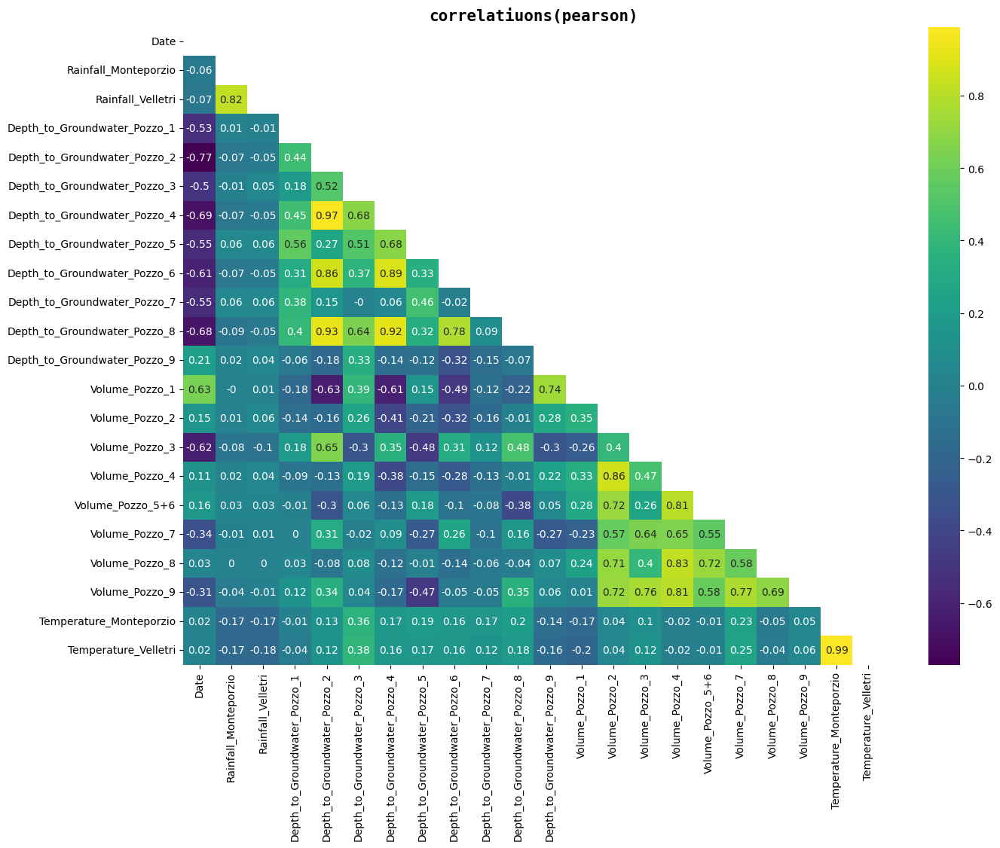

In [22]:
ds[1]['Date']=pd.to_datetime(ds[1]['Date'],dayfirst=True)

corr_plot(ds[1],'Aquifer Doganella',(20,20))

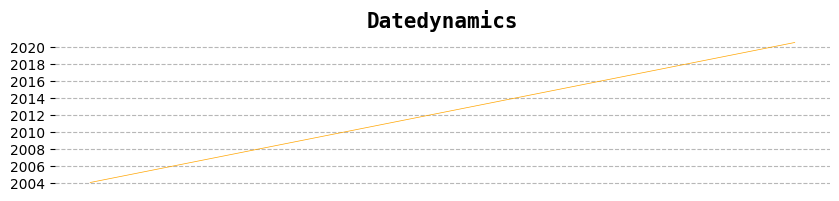

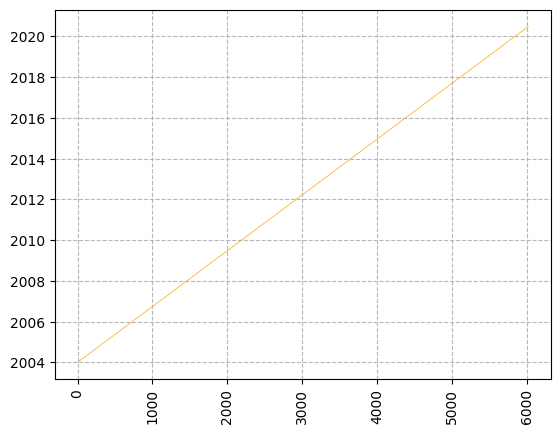

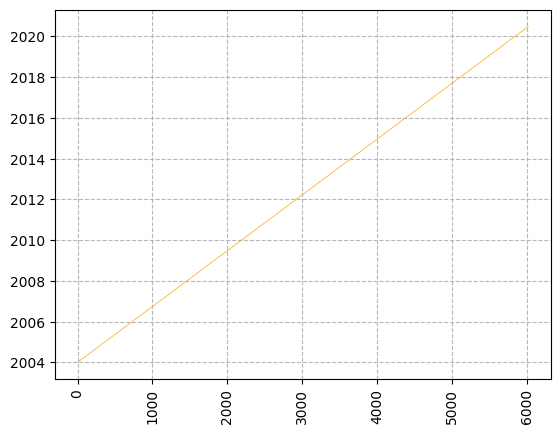

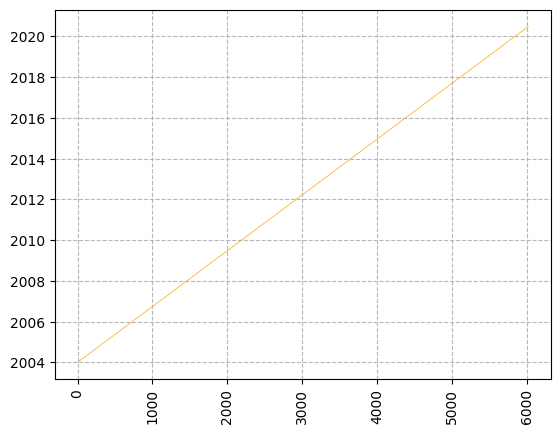

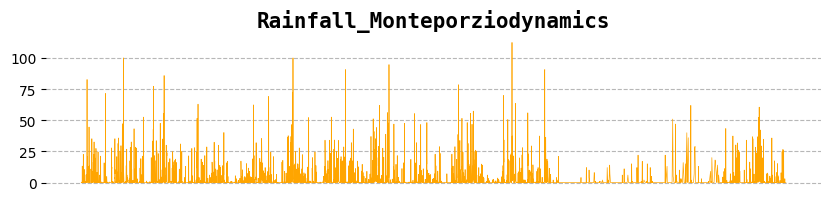

...

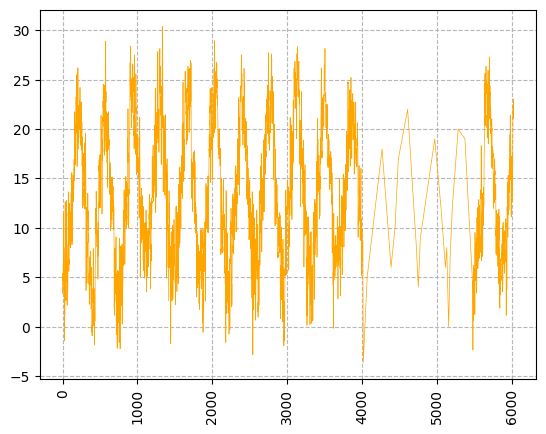

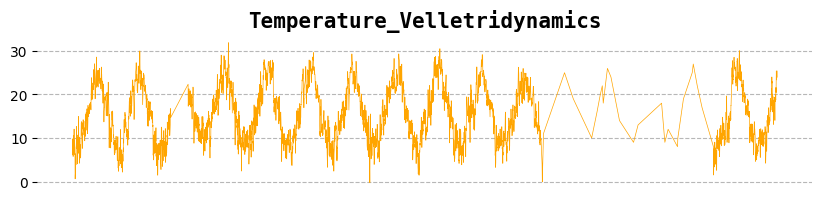

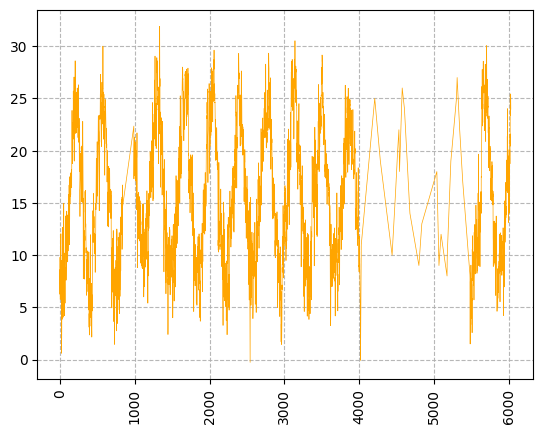

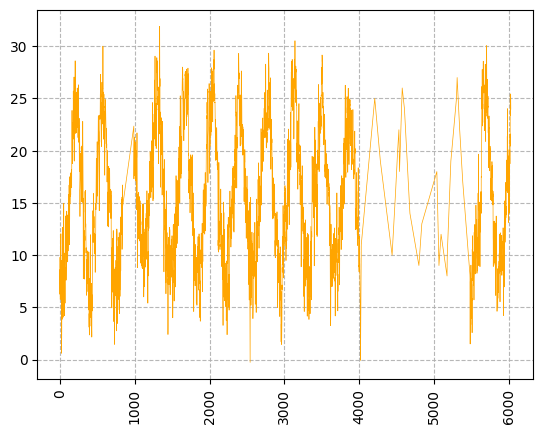

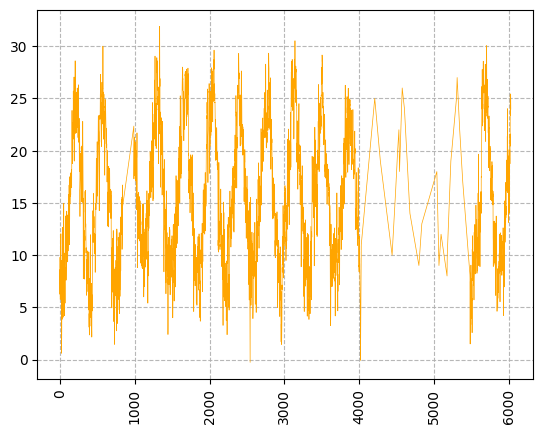

In [23]:
columns_viz(ds[1],color='orange')

In [24]:
doganella_pred= aquifer_doganella
rainfall_doganella=[col for col in doganella_pred.columns if 'Rianfall'in col]
volume_dognella=[col for col in doganella_pred.columns if 'volume' in col]

doganella_pred['rainfall_mean']=doganella_pred[rainfall_doganella].mean(axis=1).values
doganella_pred['volume_meam']=doganella_pred[volume_dognella].mean(axis=1).values

doganella_pred=doganella_pred.drop(['Temperature_Monteporzio','Temperature_Velletri'], axis=1)
doganella_pred=doganella_pred.fillna(doganella_pred.interpolate())
doganella_pred=doganella_pred.bfill()

In [25]:
depth = [col for col in doganella_pred.columns if 'Depth_to_Groundwater' in col]

y1=doganella_pred[depth]
x1=doganella_pred.drop(depth, axis=1)

x_train_doganella, x_test_doganella, y_train_dognella,y_test_dognella = train_test_split(x1,y1, test_size=0.2,random_state=42,shuffle=False)



In [26]:
doganella_params={'n_estimators': 200, 'max_depth':2 , 'subsample':1,'learning_rate':0.04,'random_state':0,'enable_categorical':True }

x_train_doganella['Date']=x_train_doganella['Date'].astype('category')
x_test_doganella["Date"]=x_test_doganella['Date'].astype('category')

doganella_model=[XGBRegressor(**doganella_params)]*9
for i in range(9):
    doganella_model[i]=doganella_model[i].fit(x_train_doganella,y_train_dognella.iloc[:,i])

In [27]:
doganella_pred=[0]*9

for i in range(9):
    doganella_pred[i]=doganella_model[i].predict(x_test_doganella)
    print('mMaE value (Depth_to_Groundwater_Pozzo_{}):{}'
        .format(i+1, round(mean_absolute_error(y_test_dognella.iloc[:,i],doganella_pred[i]),4)))

mMaE value (Depth_to_Groundwater_Pozzo_1):56.0875
mMaE value (Depth_to_Groundwater_Pozzo_2):2.5035
mMaE value (Depth_to_Groundwater_Pozzo_3):16.5137
mMaE value (Depth_to_Groundwater_Pozzo_4):3.0046
mMaE value (Depth_to_Groundwater_Pozzo_5):6.2153
mMaE value (Depth_to_Groundwater_Pozzo_6):4.2849
mMaE value (Depth_to_Groundwater_Pozzo_7):1.5193
mMaE value (Depth_to_Groundwater_Pozzo_8):1.3998
mMaE value (Depth_to_Groundwater_Pozzo_9):5.8349


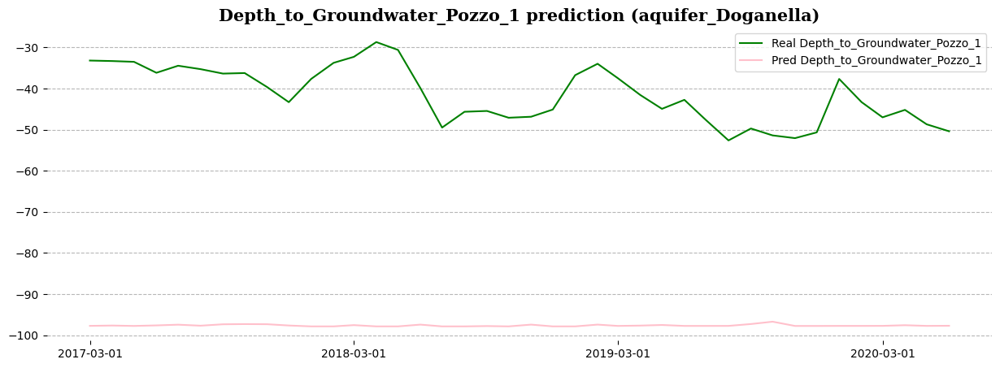

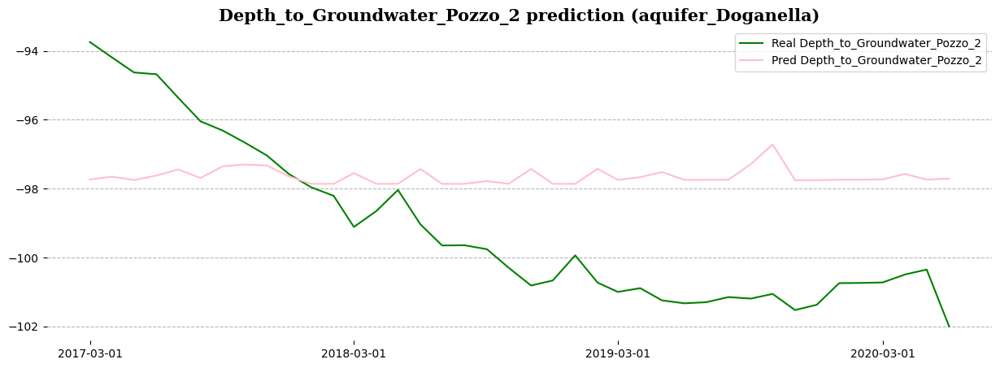

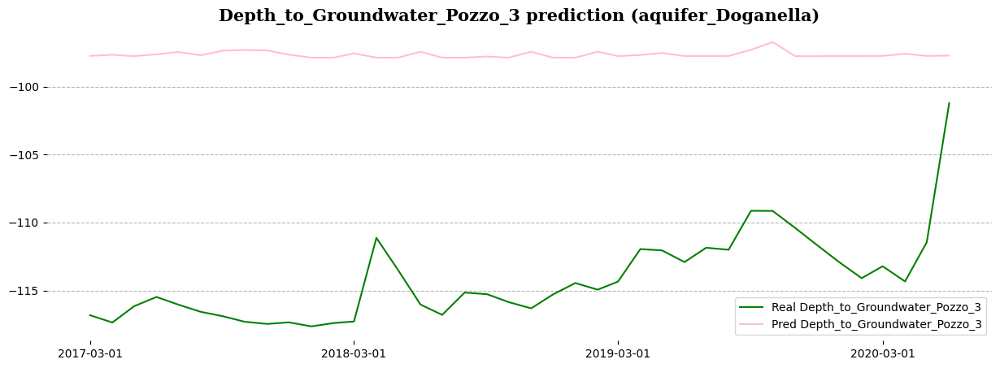

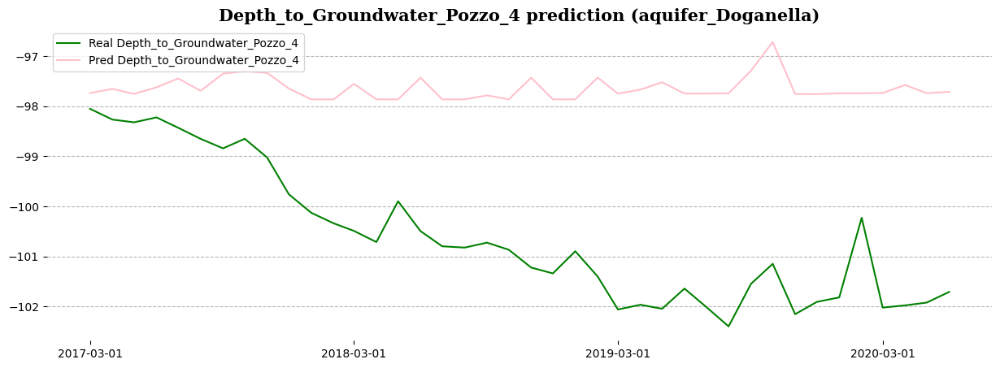

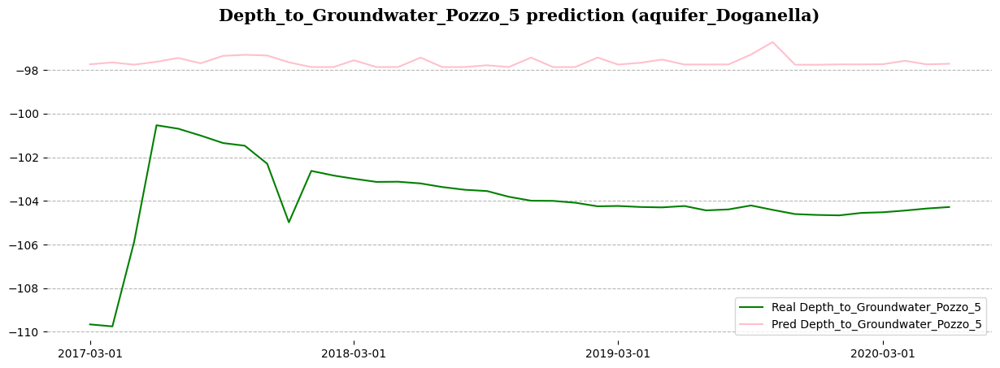

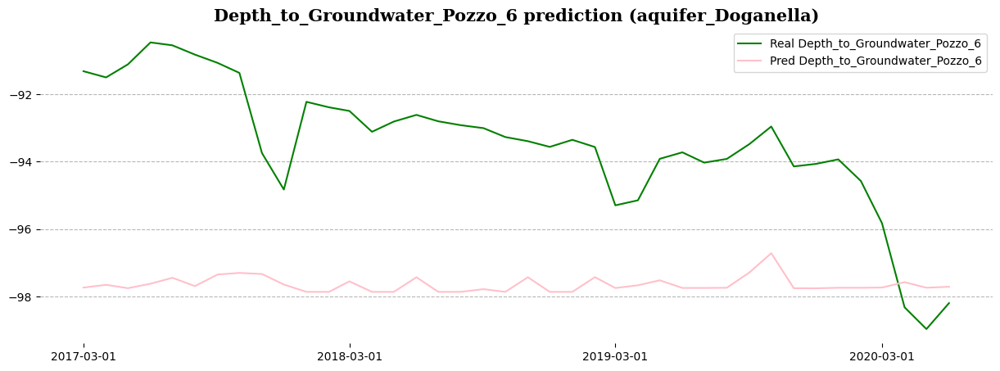

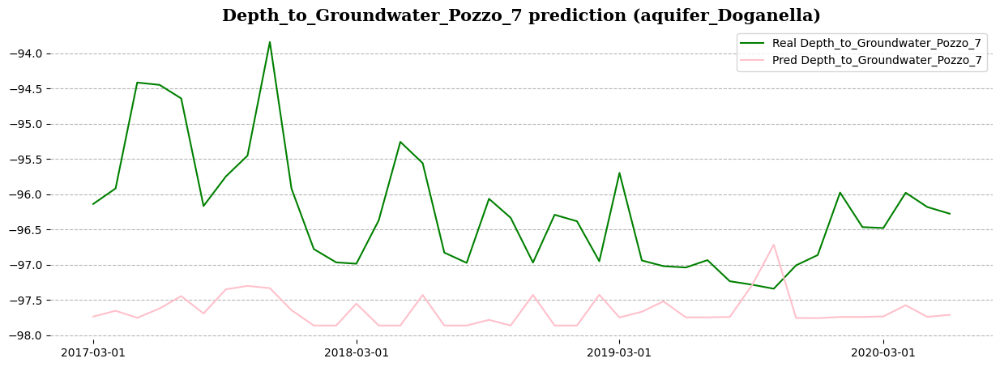

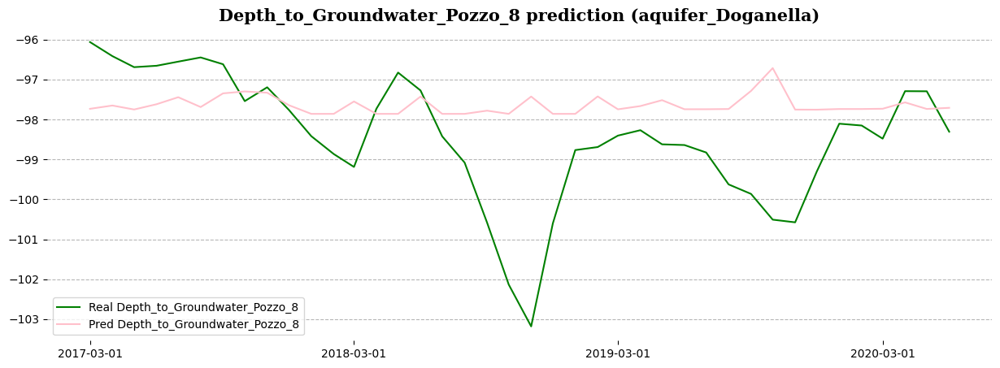

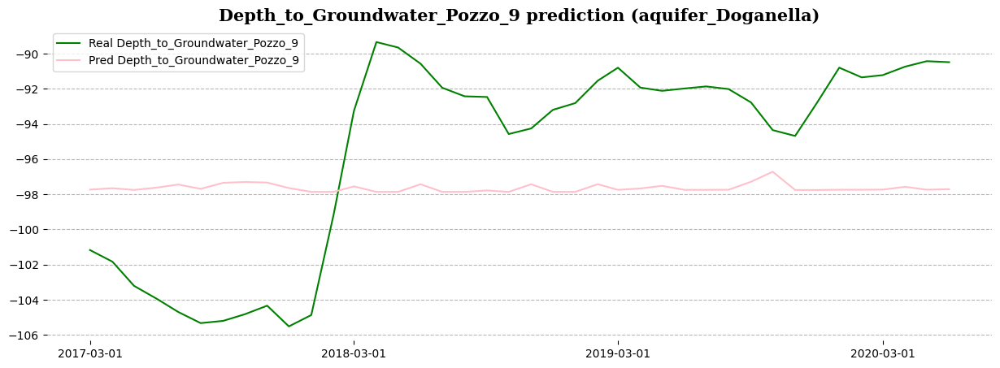

In [28]:
for i in range(9):
    predicted_viz(y_test_dognella.iloc[:,i],doganella_pred[i], f'Depth_to_Groundwater_Pozzo_{i+1}', 'aquifer_Doganella',aquifer_doganella)


Aquifer Luco

In [29]:
ds[2].head()

,Date,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
0,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.50,0.80,NaN,NaN,NaN
1,02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,6.20,3.25,NaN,NaN,NaN
2,03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.25,0.95,NaN,NaN,NaN
3,04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.00,4.20,NaN,NaN,NaN
4,05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.90,6.55,NaN,NaN,NaN


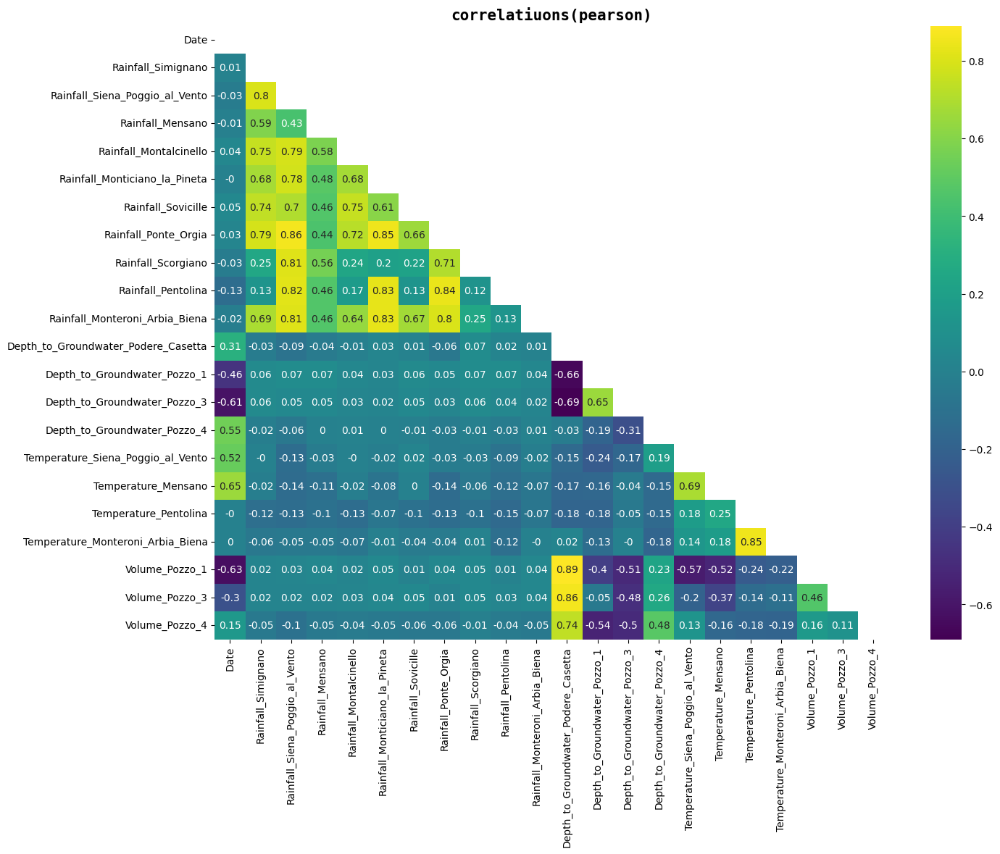

In [30]:
ds[2]['Date']= pd.to_datetime(ds[2]['Date'],dayfirst=True)

corr_plot(ds[2], 'Auifer Luco', (20,20))

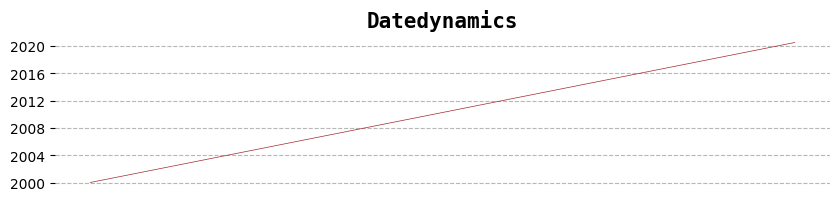

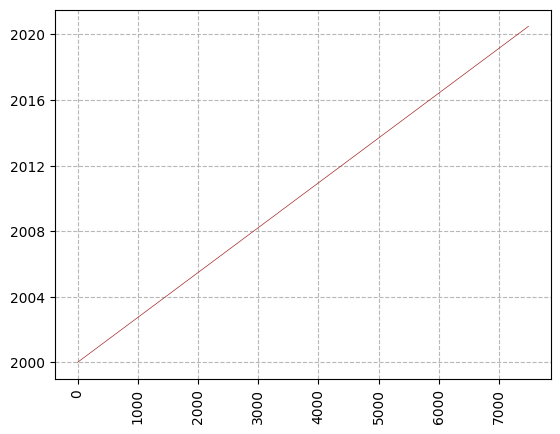

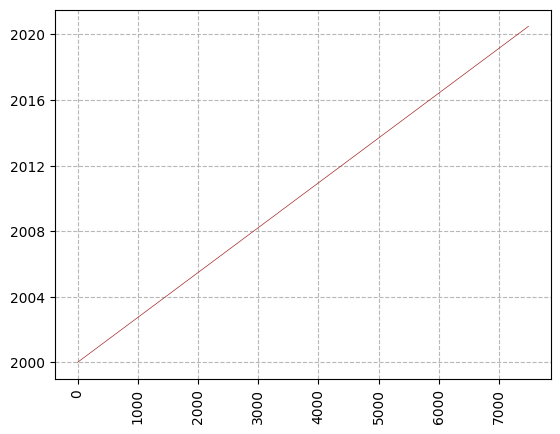

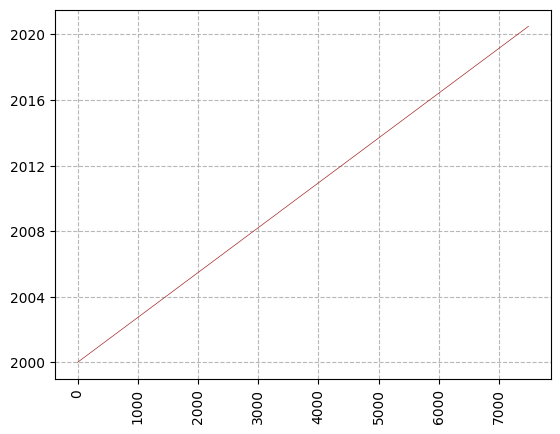

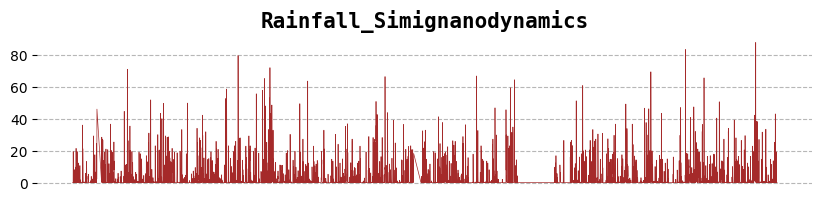

...

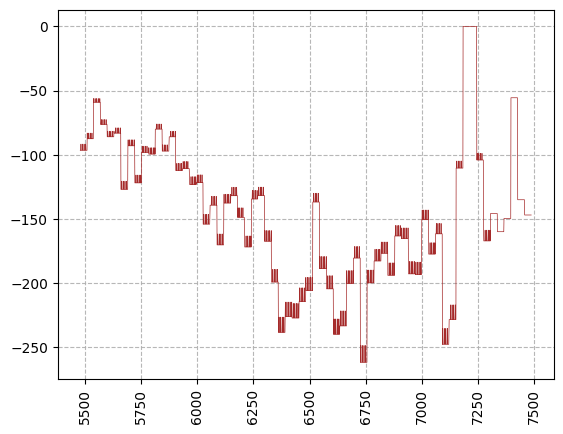

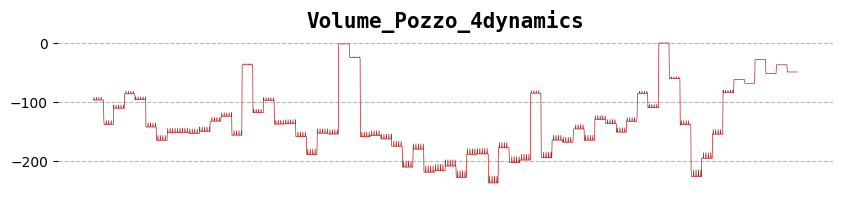

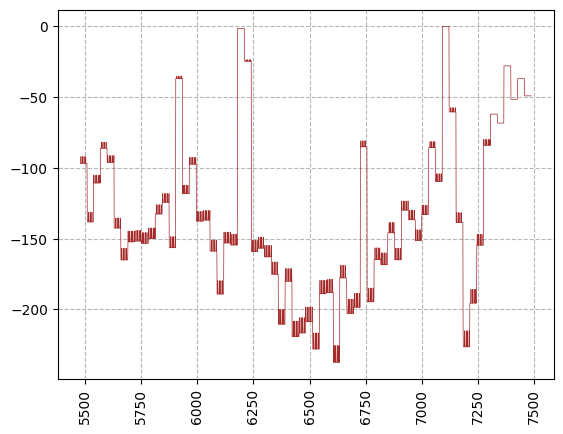

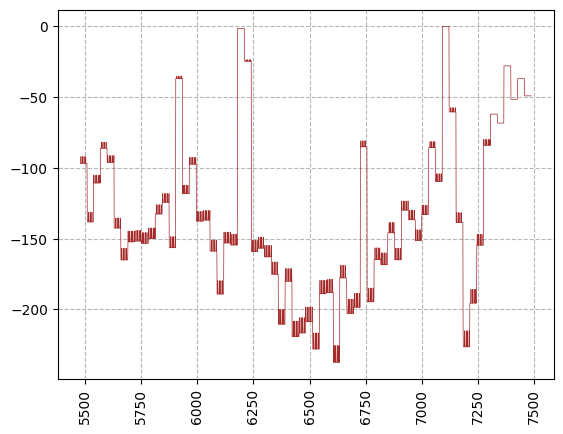

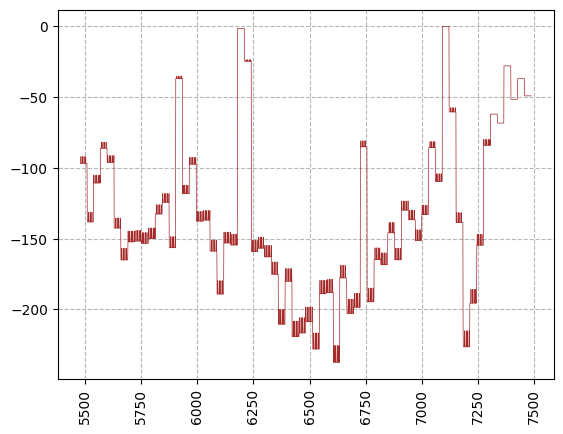

In [31]:
columns_viz(ds[2],color='brown')

In [32]:
target_var= 'Depth_to_Groundwater_Podere_Casetta'
aquifer_luco[target_var]=aquifer_luco[target_var].interpolate()

aquifer_luco=aquifer_luco.dropna(subset=[target_var])

In [33]:
luco_pred= aquifer_luco
rainfall_luco=[col for col in luco_pred.columns if 'Rainfall' in col]
temperature_luco=[col for col in luco_pred.columns if 'temperature'in col]

luco_pred['rainfall_sum']=luco_pred[rainfall_luco].sum(axis=1).values
luco_pred['temperature_mean']=luco_pred[temperature_luco].mean(axis=1).values
luco_pred=luco_pred.drop(['Rainfall_Siena_Poggio_al_Vento', 'Rainfall_Mensano',
                        'Rainfall_Monticiano_la_Pineta', 'Rainfall_Ponte_Orgia',
                        'Rainfall_Scorgiano', 'Rainfall_Pentolina',
                        'Rainfall_Monteroni_Arbia_Biena',
                        'Depth_to_Groundwater_Pozzo_1', 'Depth_to_Groundwater_Pozzo_3',
                        'Depth_to_Groundwater_Pozzo_4', 'Temperature_Siena_Poggio_al_Vento', 
                        'Temperature_Mensano', 'Volume_Pozzo_1',
                        'Volume_Pozzo_3', 'Volume_Pozzo_4'], axis = 1)

luco_pred=luco_pred.fillna(luco_pred.interpolate())

luco_pred.shape

/tmp/ipykernel_569/4054506905.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  luco_pred['rainfall_sum']=luco_pred[rainfall_luco].sum(axis=1).values
/tmp/ipykernel_569/4054506905.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  luco_pred['temperature_mean']=luco_pred[temperature_luco].mean(axis=1).values


(4514, 9)

In [34]:
y2=luco_pred[['Depth_to_Groundwater_Podere_Casetta']]

x2=luco_pred.drop(['Depth_to_Groundwater_Podere_Casetta'], axis=1)

x_train_luco,x_test_luco,y_train_luco,y_test_luco= train_test_split(x2,y2,test_size=0.2, random_state=42, shuffle=False)



In [35]:
luco_params = {'n_estimators': 200,'max_depth': 2,'subsample': 1,'learning_rate': 0.04,'random_state': 0,'enable_categorical': True}

x_train_luco['Date']= x_train_luco['Date'].astype('category')

x_test_luco['Date']=x_test_luco['Date'].astype('category')

luco_model=XGBRegressor(**luco_params)

luco_model.fit(x_train_luco, y_train_luco)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=True, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.04, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=2, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [36]:
luco_y_pred=luco_model.predict(x_test_luco)

print('MaE VALUE:',mean_absolute_error(y_test_luco ,luco_y_pred))

MaE VALUE: 0.6996361653274081


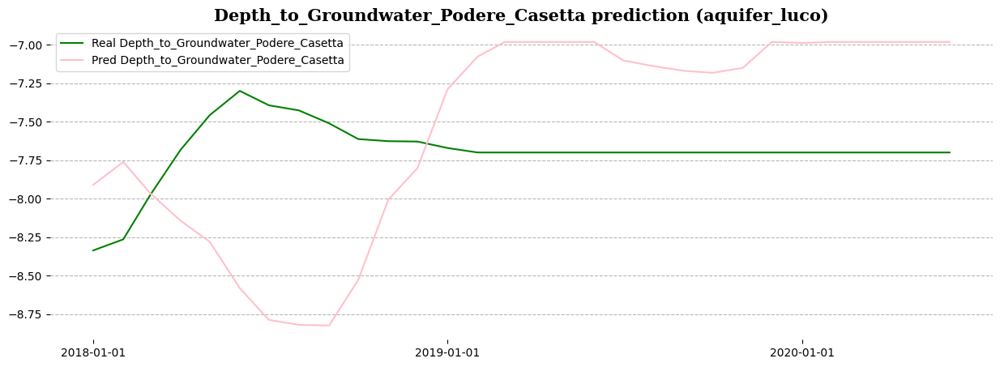

In [37]:
predicted_viz(y_test_luco , luco_y_pred,'Depth_to_Groundwater_Podere_Casetta', 'aquifer_luco',aquifer_luco)

Aquifer Petrignano

In [38]:
ds[3].head()

,Date,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
0,14/03/2006,NaN,-22.48,-22.18,NaN,NaN,NaN,NaN
1,15/03/2006,NaN,-22.38,-22.14,NaN,NaN,NaN,NaN
2,16/03/2006,NaN,-22.25,-22.04,NaN,NaN,NaN,NaN
3,17/03/2006,NaN,-22.38,-22.04,NaN,NaN,NaN,NaN
4,18/03/2006,NaN,-22.60,-22.04,NaN,NaN,NaN,NaN


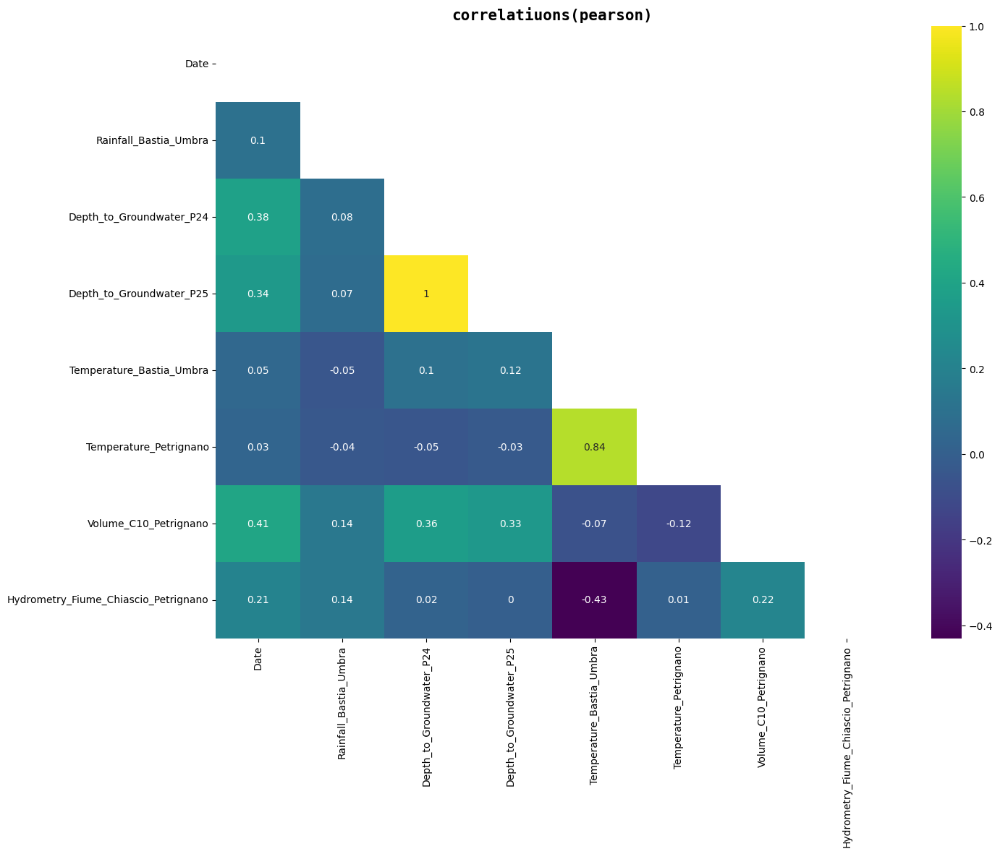

In [39]:
ds[3]['Date']=pd.to_datetime(ds[3]['Date'],dayfirst=True)

corr_plot(ds[3],'Aquifer Petrignano',(20,20))

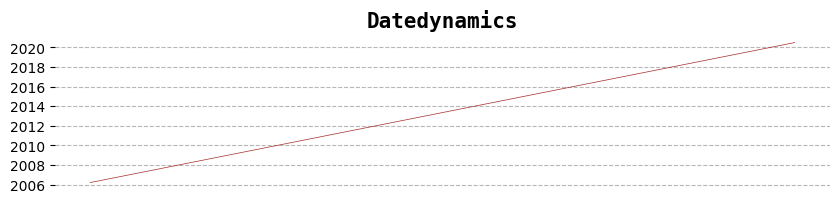

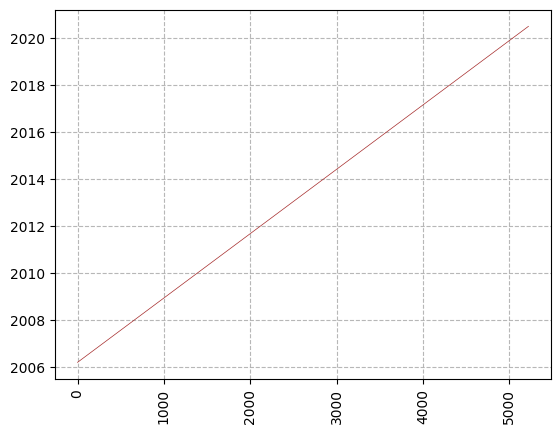

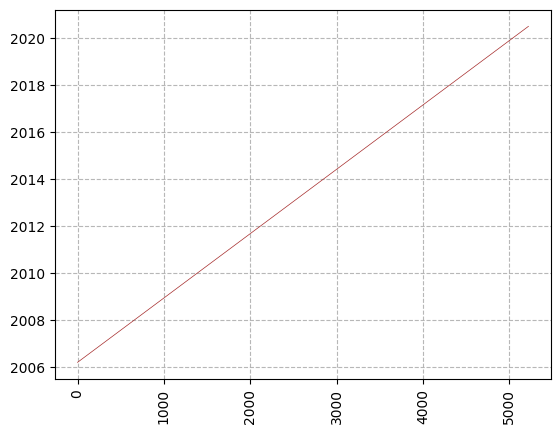

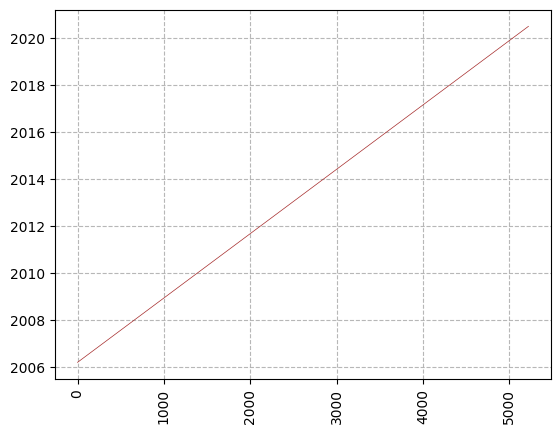

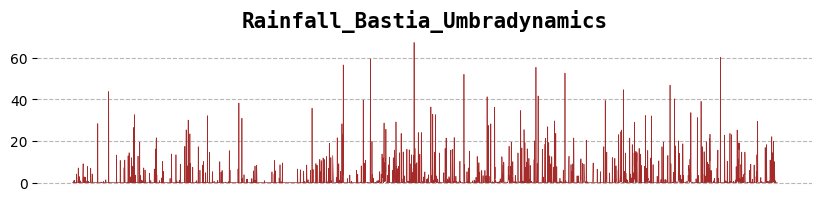

...

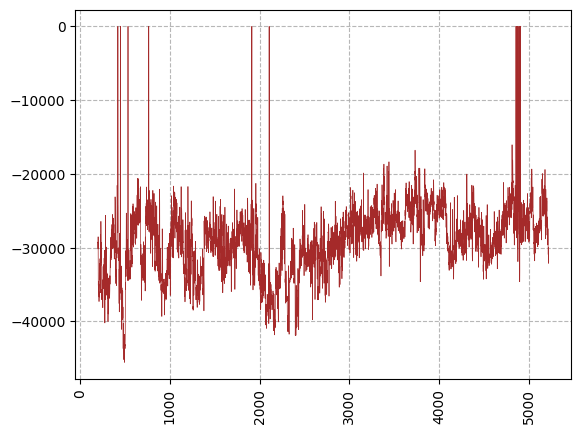

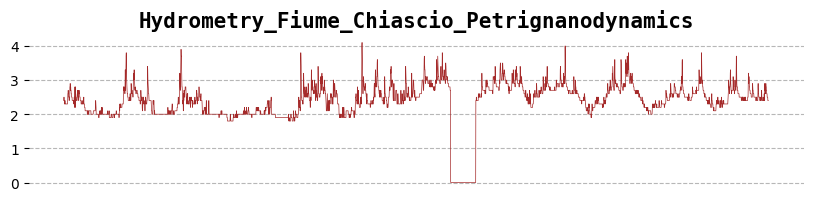

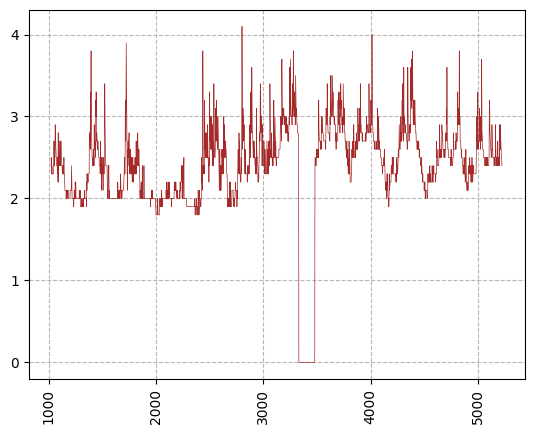

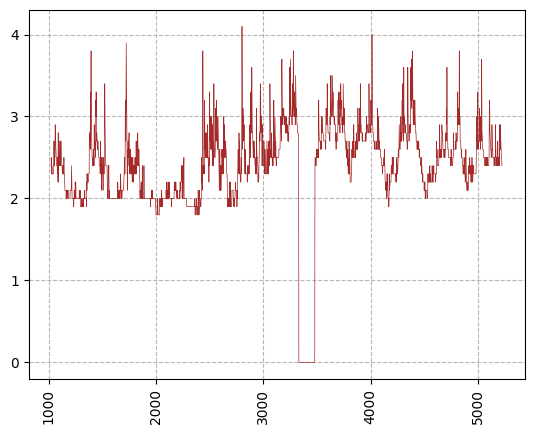

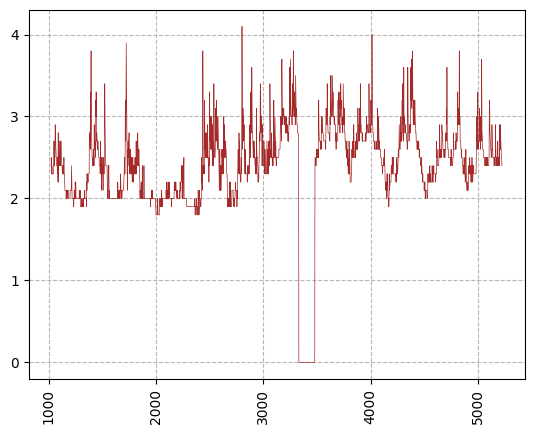

In [40]:
columns_viz(ds[3], color='brown')

In [41]:
petrignano_pred= aquifer_petrignano
temperature_petrignano=[col for col in petrignano_pred.columns if 'Temperature' in col]
petrignano_pred['temperature_mean']= petrignano_pred[temperature_petrignano].mean(axis=1).values
petrignano_pred=petrignano_pred.dropna()

petrignano_pred.shape


(4150, 9)

In [42]:
y3_p24=petrignano_pred['Depth_to_Groundwater_P24']
y3_p25=petrignano_pred['Depth_to_Groundwater_P25']
x3=petrignano_pred.drop(['Depth_to_Groundwater_P24', 'Depth_to_Groundwater_P25'], axis = 1)

x_train_petrignano_p24, x_test_petrignano_p24,y_train_petrignano_p24,y_test_petrignano_p24 = train_test_split(x3,y3_p24,test_size=0.2, random_state=42, shuffle=False)
x_train_petrignano_p25, x_test_petrignano_p25,y_train_petrignano_p25,y_test_petrignano_p25 = train_test_split(x3,y3_p25,test_size=0.2, random_state=42, shuffle=False)

x_train_petrignano_p24['Date']=pd.to_datetime(x_train_petrignano_p24['Date'])
x_test_petrignano_p25['Date']=pd.to_datetime(x_test_petrignano_p25['Date'])
x_test_petrignano_p24['Date']=pd.to_datetime(x_test_petrignano_p24['Date'])
x_test_petrignano_p25['Date']=pd.to_datetime(x_test_petrignano_p25['Date'])

x_train_petrignano_p24['Year']=x_train_petrignano_p24['Date'].dt.year
x_train_petrignano_p24['Month']=x_train_petrignano_p24['Date'].dt.month
x_train_petrignano_p24['Day']=x_train_petrignano_p24['Date'].dt.day

x_train_petrignano_p25['Year']=x_train_petrignano_p25['Date'].dt.year
x_train_petrignano_p25['Month']=x_train_petrignano_p25['Date'].dt.month
x_train_petrignano_p25['Day']=x_train_petrignano_p25['Date'].dt.day


x_test_petrignano_p24['Year']=x_test_petrignano_p24['Date'].dt.year
x_test_petrignano_p24['Month']=x_test_petrignano_p24['Date'].dt.month
x_test_petrignano_p24['Day']=x_test_petrignano_p24['Date'].dt.day


x_test_petrignano_p25['Year']=x_test_petrignano_p25['Date'].dt.year
x_test_petrignano_p25['Month']=x_test_petrignano_p25['Date'].dt.month
x_test_petrignano_p25['Day']=x_test_petrignano_p25['Date'].dt.day

x_train_petrignano_p24=x_train_petrignano_p24.drop('Date',axis=1)
x_test_petrignano_p24=x_test_petrignano_p24.drop('Date',axis=1)


x_train_petrignano_p25=x_train_petrignano_p25.drop('Date',axis=1)
x_test_petrignano_p25=x_test_petrignano_p25.drop('Date',axis=1)


petrignano_params={'n_estimators': 200, 'max_depth': 2,'subsample': 1,'learning_rate': 0.04,'random_state': 0,'enable_categorical': True}

petrigano_model_p24=XGBRegressor(**petrignano_params)
petrigano_model_p24.fit(x_train_petrignano_p24, y_train_petrignano_p24)

petrigano_model_p25=XGBRegressor(**petrignano_params)
petrigano_model_p25.fit(x_train_petrignano_p25, y_train_petrignano_p25)



XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=True, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.04, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=2, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [43]:
petrignano_pred_p24=petrigano_model_p24.predict(x_test_petrignano_p24)

petrignano_pred_p25=petrigano_model_p25.predict(x_test_petrignano_p25)

print('MAE value (Depth_to_Groundwater_P24): ', mean_absolute_error(y_test_petrignano_p24, petrignano_pred_p24))
print('MAE value (Depth_to_Groundwater_P25): ', mean_absolute_error(y_test_petrignano_p25, petrignano_pred_p25))

MAE value (Depth_to_Groundwater_P24):  1.1685788850899204
MAE value (Depth_to_Groundwater_P25):  1.1255651171580856


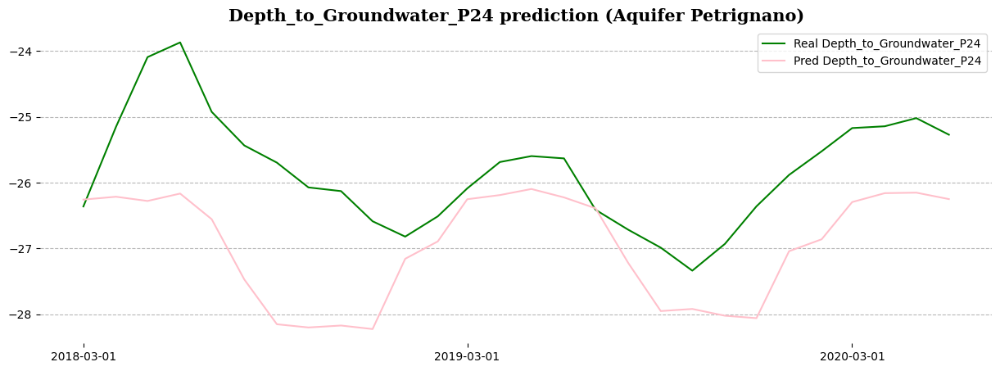

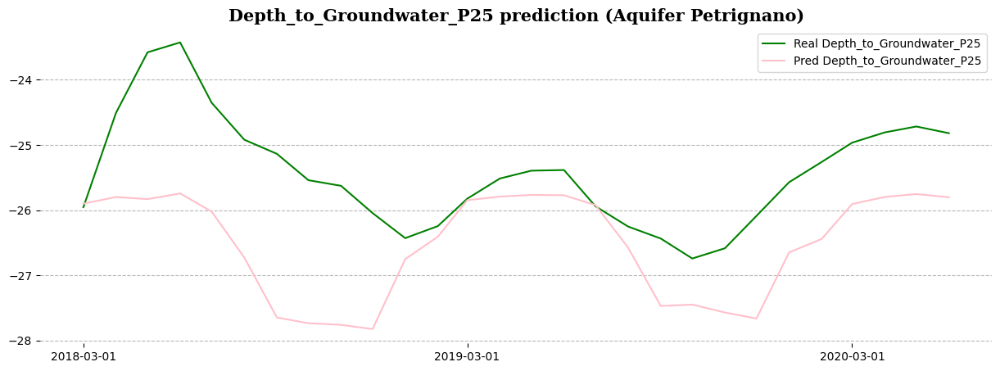

In [44]:
predicted_viz(y_test_petrignano_p24,petrignano_pred_p24, 'Depth_to_Groundwater_P24', 'Aquifer Petrignano', aquifer_petrignano)

predicted_viz(y_test_petrignano_p25, petrignano_pred_p25, 'Depth_to_Groundwater_P25', 'Aquifer Petrignano', aquifer_petrignano)



Lake Biliancino


In [45]:
ds[4].head()

,Date,Rainfall_S_Piero,Rainfall_Mangona,Rainfall_S_Agata,Rainfall_Cavallina,Rainfall_Le_Croci,Temperature_Le_Croci,Lake_Level,Flow_Rate
0,03/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
1,04/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
2,05/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
3,06/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
4,07/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.44,0.31


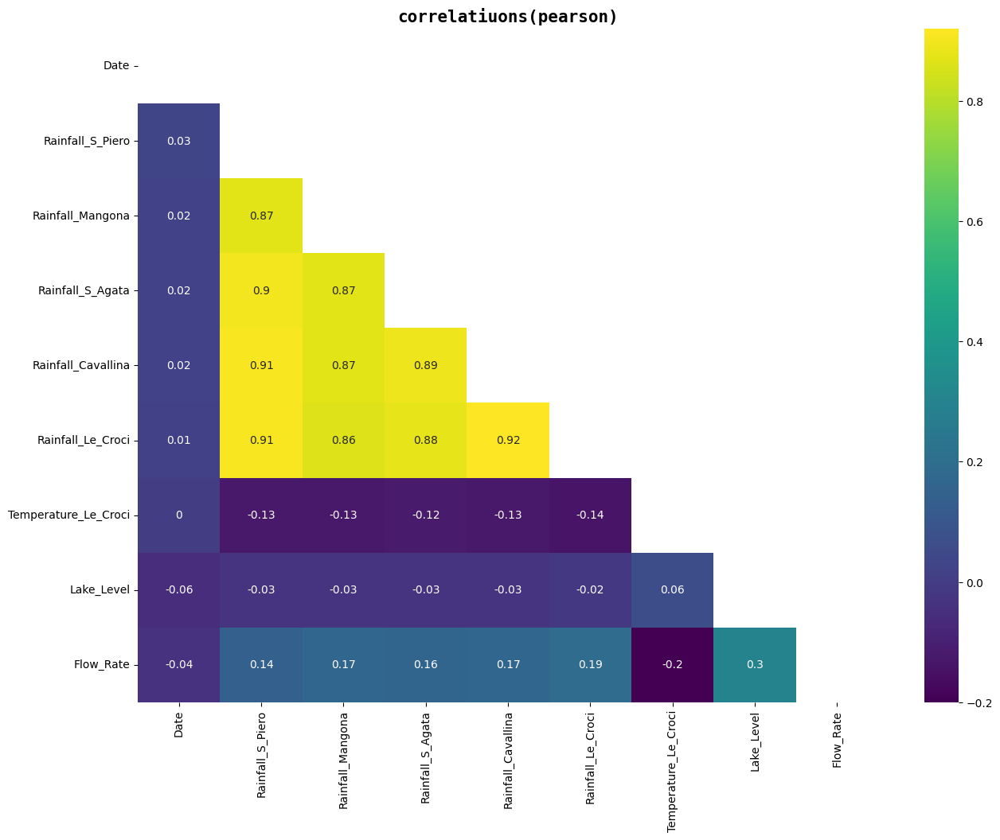

In [46]:
ds[4]['Date']=pd.to_datetime(ds[4]['Date'],dayfirst=True)

corr_plot(ds[4], 'Lake Biliancino',(20,20))

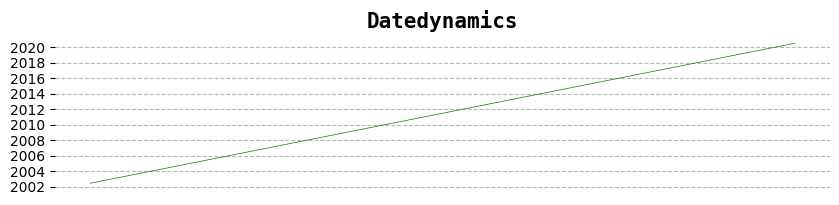

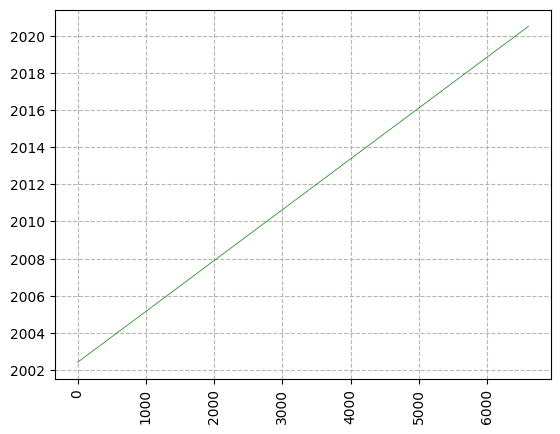

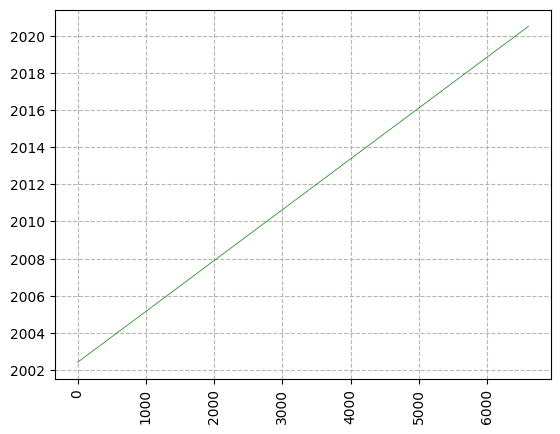

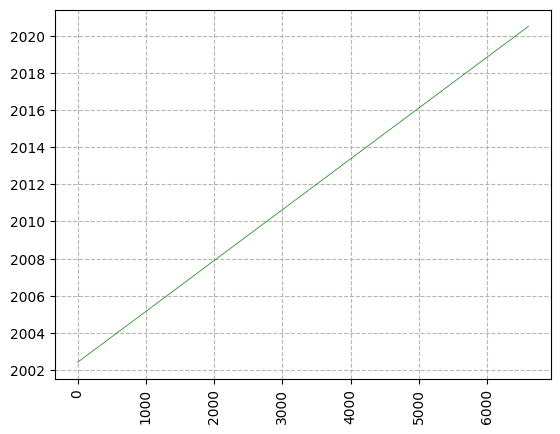

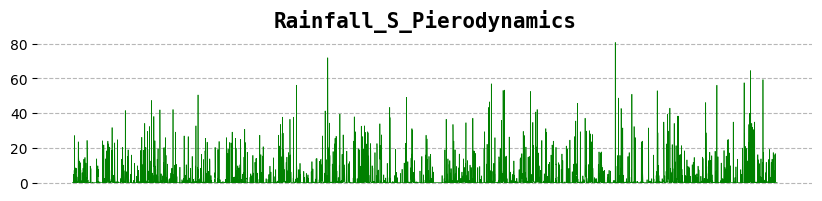

...

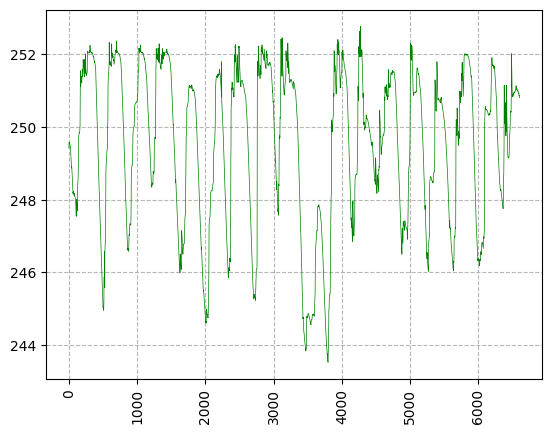

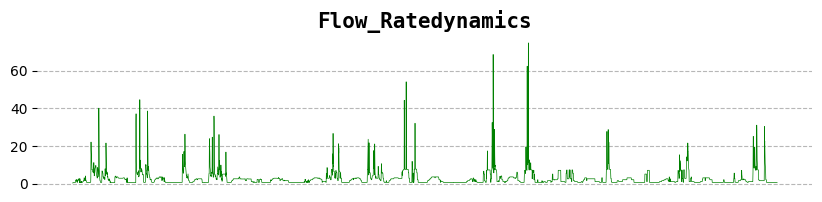

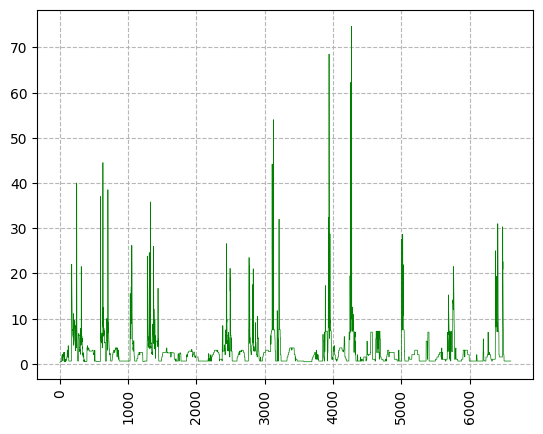

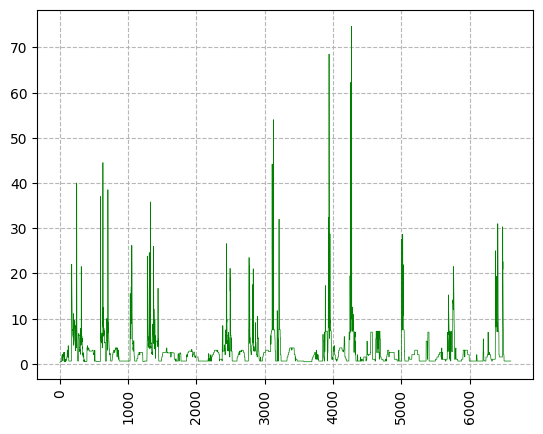

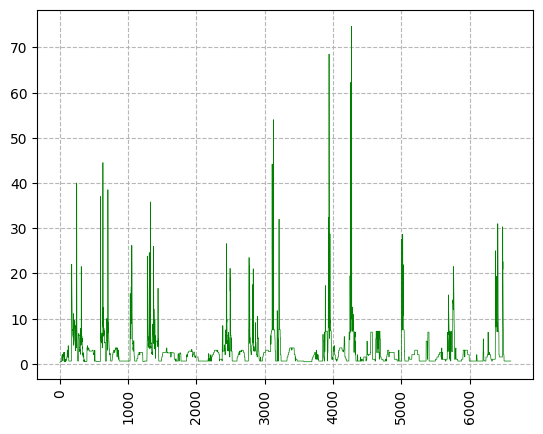

In [47]:
columns_viz(ds[4], color='green')

In [48]:
biliancino_pred = Lake_Bilancino
biliancino_pred['Date'] = pd.to_datetime(biliancino_pred['Date'])
biliancino_pred['Year'] = biliancino_pred['Date'].dt.year
biliancino_pred['Month'] = biliancino_pred['Date'].dt.month
biliancino_pred['Day'] = biliancino_pred['Date'].dt.day

biliancino_pred = biliancino_pred.drop('Date', axis=1)

rainfall_biliancino = [col for col in biliancino_pred.columns if 'Rainfall' in col]

biliancino_pred['rainfall_mean'] = biliancino_pred[rainfall_biliancino].mean(axis = 1).values


In [49]:
y_level_biliancino=biliancino_pred['Lake_level']
y_flow_biliancino=biliancino_pred['Flow_rate']
x4=biliancino_pred.drop(['Lake_Level','Flow_Rate'],axis=1)

vaild_indices= y_flow_biliancino.dropna().index
y_flow_biliancino_cleaned=y_flow_biliancino.loc[vaild_indices]
x4_cleaned=x4.loc[vaild_indices]

x_train_biliancino_level, x_test_biliancino_level,y_train_biliancino_level,y_test_biliancino_level= train_test_split(x4,y_level_biliancino, test_size=0.2,random_state=42,shuffle=False)
x_train_biliancino_flow,x_test_biliancino_flow,y_train_biliancino_flow,y_test_biliancino_flow=train_test_split(x4_cleaned,y_flow_biliancino_cleaned,test_size=0.2, random_state=42, shuffle=False)



KeyError: 'Lake_level'

In [ ]:
params_biliancino={'n_estimators':200,
                   'max_depth':2,
                   'subsample':1,
                   'learning_rate':0.04,
                   'random_state': 0,
                   'enable_categorical':True}


model_level_biliancino=XGBRegressor(**params_biliancino)
model_flow_biliancino=XGBRegressor(**params_biliancino)

model_level_biliancino.fit(x_train_biliancino_level,y_train_biliancino_level)
model_flow_biliancino.fit(x_train_biliancino_flow,y_train_biliancino_flow)



In [ ]:
biliancino_pred_level=model_level_biliancino.predict(x_test_biliancino_level)
biliancino_pred_flow=model_flow_biliancino.predict(x_test_biliancino_flow)

print('MAE value (Lake_Level): ', mean_absolute_error(y_test_biliancino_level, biliancino_pred_level))
print('MAE value (Flow_Rate): ', mean_absolute_error(y_test_biliancino_flow, biliancino_pred_flow))

NameError: name 'model_level_biliancino' is not defined

In [ ]:
predicted_viz(y_test_biliancino_level,biliancino_pred_level,'Lake_level','Lake Biliancino', Lake_Bilancino)
predicted_viz(y_test_biliancino_flow,biliancino_pred_flow,'flow_rate','Lake Biliancino', Lake_Bilancino)



NameError: name 'predicted_viz' is not defined

River Arno

In [ ]:
ds[5].head()

,Date,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,Rainfall_Vernio,Rainfall_Stia,Rainfall_Consuma,Rainfall_Incisa,Rainfall_Montevarchi,Rainfall_S_Savino,Rainfall_Laterina,Rainfall_Bibbiena,Rainfall_Camaldoli,Temperature_Firenze,Hydrometry_Nave_di_Rosano
0,01/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.82
1,02/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.94
2,03/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.11
3,04/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.84
4,05/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.88


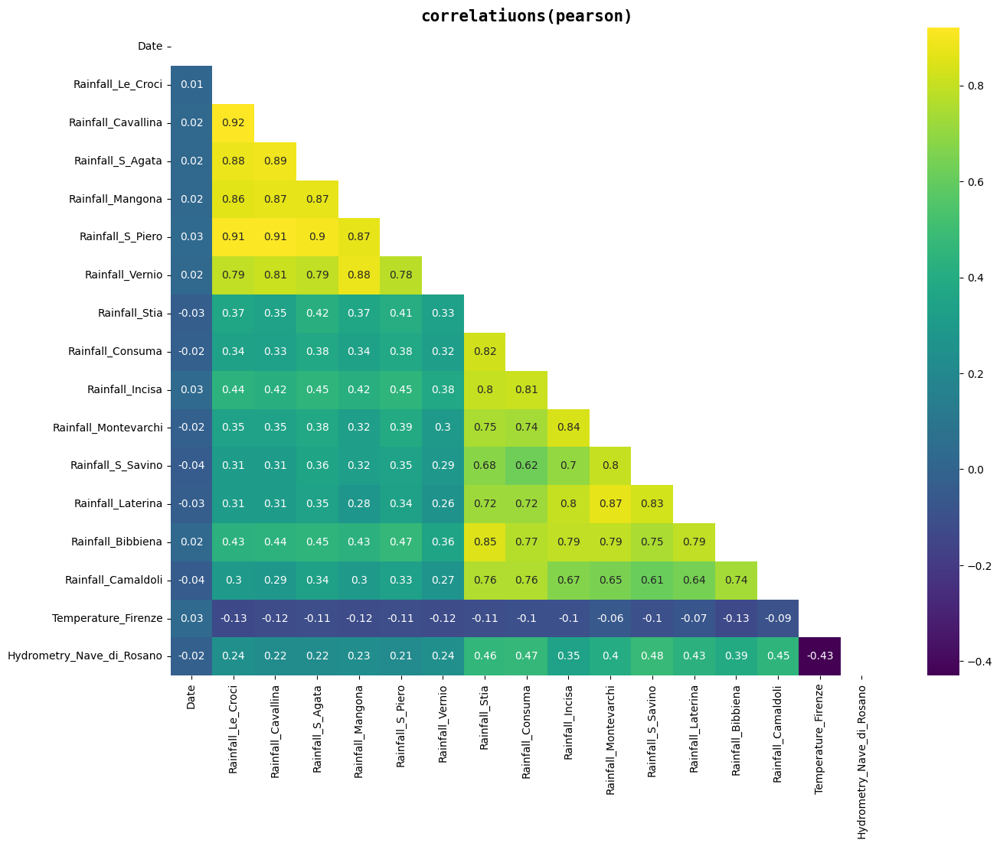

In [ ]:
ds[5]['Date']=pd.to_datetime(ds[5]['Date'], dayfirst=True)
corr_plot(ds[5],'River Arno',(20,20))

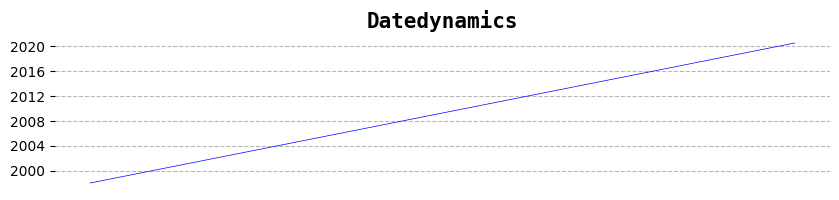

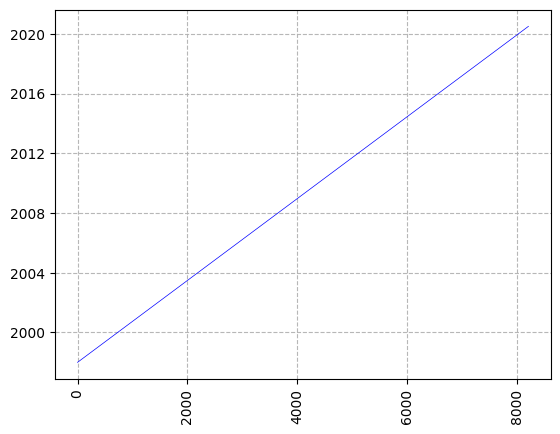

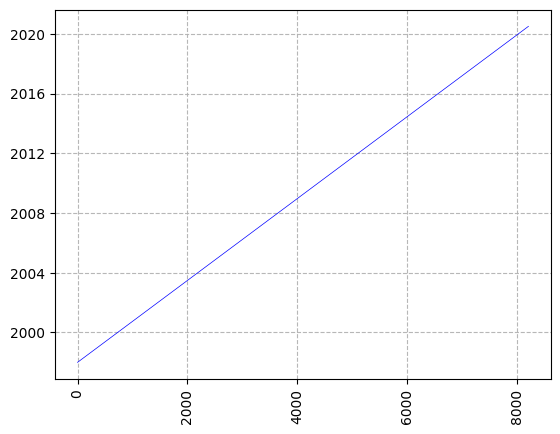

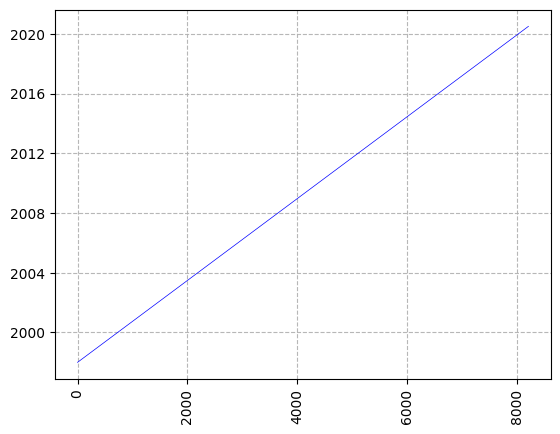

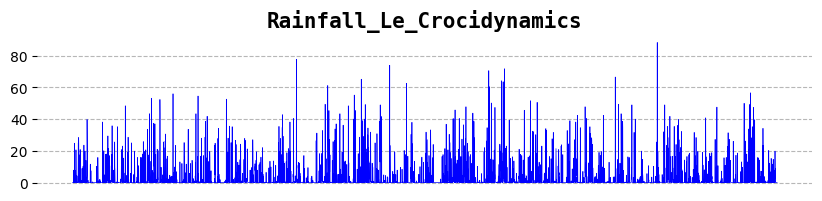

...

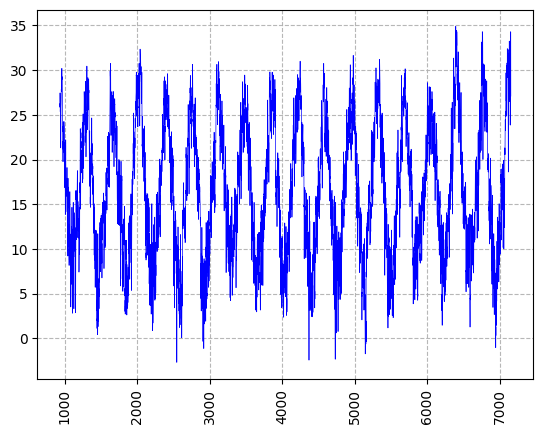

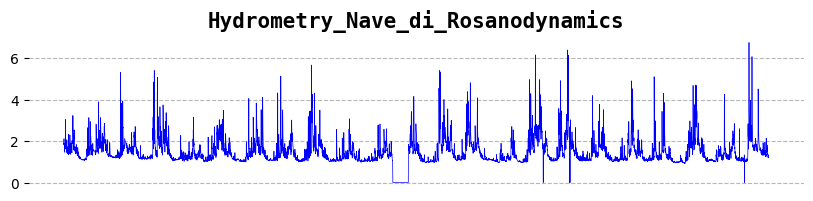

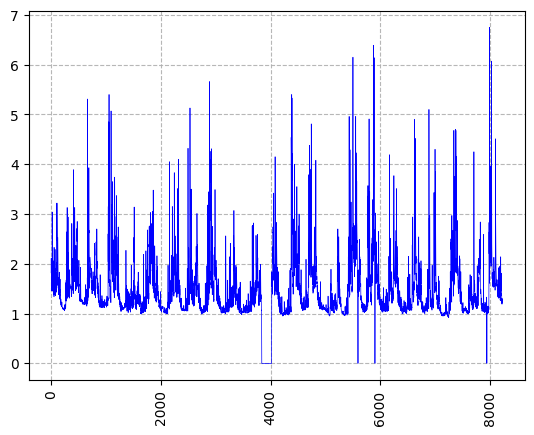

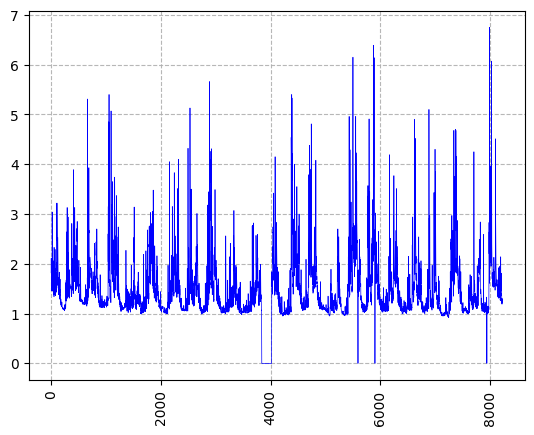

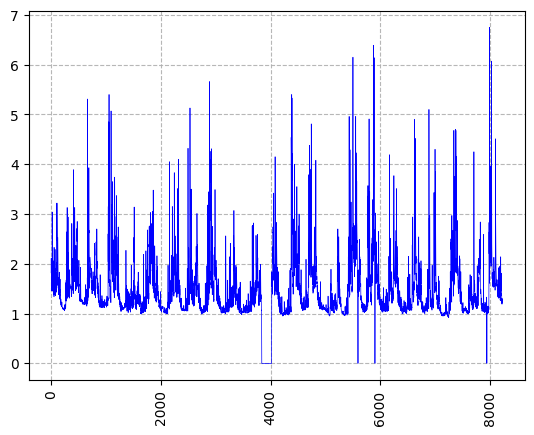

In [ ]:
columns_viz(ds[5],color='blue')

In [ ]:
arno_pred=river_arno[['Hydrometry_Nave_di_Rosano', 'Temperature_Firenze', 
                      'Rainfall_Le_Croci', 'Rainfall_Cavallina', 
                      'Rainfall_S_Agata', 'Rainfall_Mangona', 'Rainfall_S_Piero']]

arno_pred=arno_pred.apply(lambda x: x.fillna(x.mean()))

arno_pred['rainfall_mean']= arno_pred[['Rainfall_Le_Croci', 'Rainfall_Cavallina', 
                                    'Rainfall_S_Agata', 'Rainfall_Mangona', 
                                    'Rainfall_S_Piero']].mean(axis=1).values


arno_pred.shape 

(8217, 8)

In [ ]:
y5=arno_pred[['Hydrometry_Nave_di_Rosano']]
x5=arno_pred.drop(['Hydrometry_Nave_di_Rosano'],axis=1)

x_train_arno,x_test_arno,y_train_arno,y_test_arno= train_test_split(x5,y5,test_size=0.2,random_state=42,shuffle=False)

params_arno={'n_estimators': 200,
            'max_depth': 2,
            'subsample': 1,
            'learning_rate': 0.04,
            'random_state': 0,
            'enable_categorical': True}

arno_model=XGBRegressor(**params_arno)

arno_model.fit(x_train_arno,y_train_arno)


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=True, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.04, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=2, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [ ]:
arno_y_pred=arno_model.predict(x_test_arno)

print('MAE value:',mean_absolute_error(y_test_arno, arno_y_pred))



MAE value: 0.3843563281229262


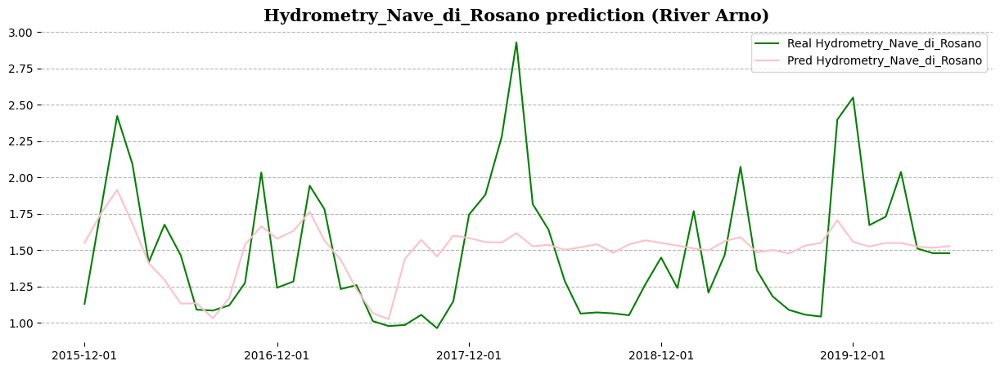

In [ ]:
predicted_viz(y_test_arno,arno_y_pred,'Hydrometry_Nave_di_Rosano', 'River Arno', river_arno)

Water Spring Amiata


In [ ]:
ds[6].head()

,Date,Rainfall_Castel_del_Piano,Rainfall_Abbadia_S_Salvatore,Rainfall_S_Fiora,Rainfall_Laghetto_Verde,Rainfall_Vetta_Amiata,Depth_to_Groundwater_S_Fiora_8,Depth_to_Groundwater_S_Fiora_11bis,Depth_to_Groundwater_David_Lazzaretti,Temperature_Abbadia_S_Salvatore,Temperature_S_Fiora,Temperature_Laghetto_Verde,Flow_Rate_Bugnano,Flow_Rate_Arbure,Flow_Rate_Ermicciolo,Flow_Rate_Galleria_Alta
0,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.15,NaN,NaN,NaN,NaN,NaN
1,02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.55,NaN,NaN,NaN,NaN,NaN
2,03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.70,NaN,NaN,NaN,NaN,NaN
3,04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.00,NaN,NaN,NaN,NaN,NaN
4,05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.60,NaN,NaN,NaN,NaN,NaN


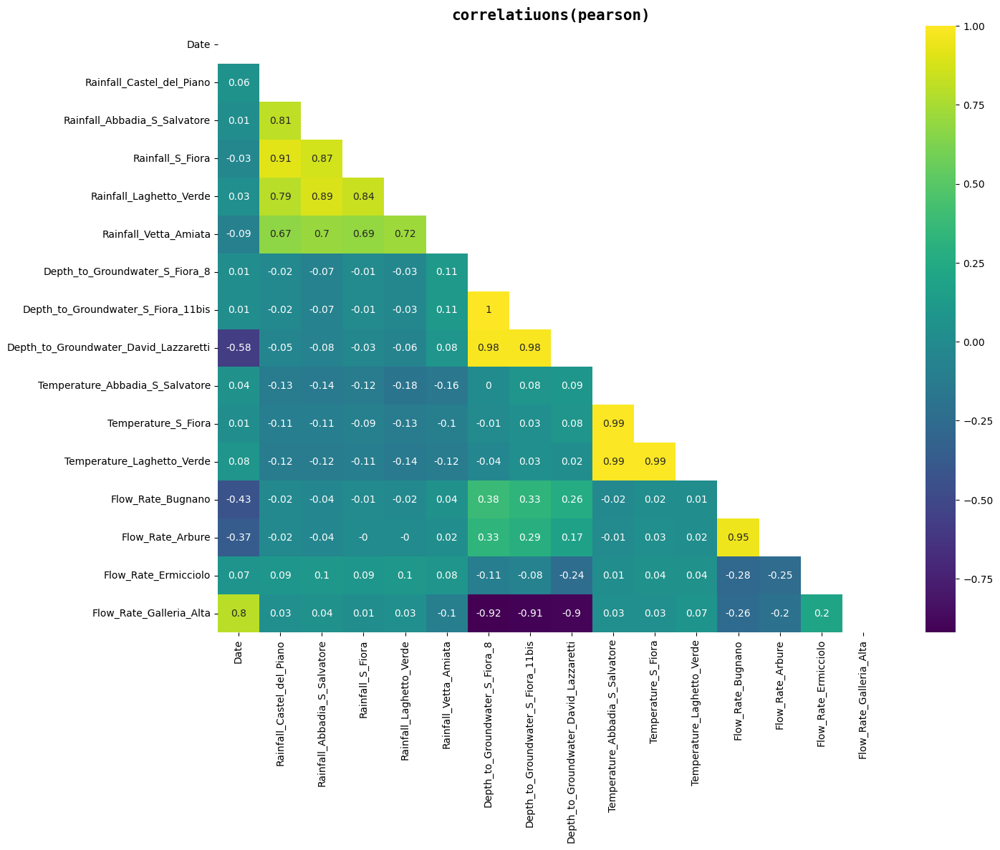

In [ ]:
ds[6]['Date']=pd.to_datetime(ds[6]['Date'], dayfirst=True)

corr_plot(ds[6],'Water Spring Amiata', (20, 20))


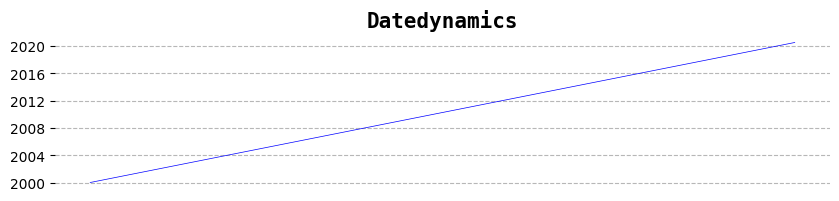

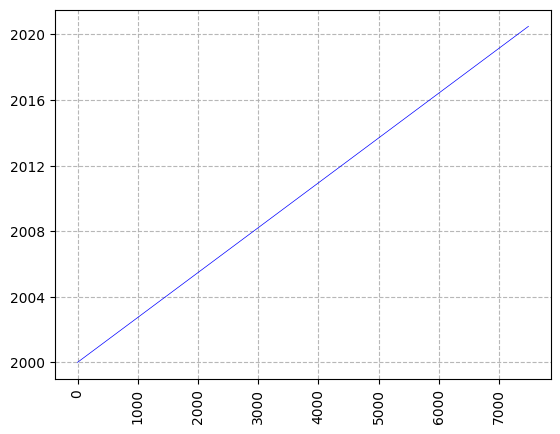

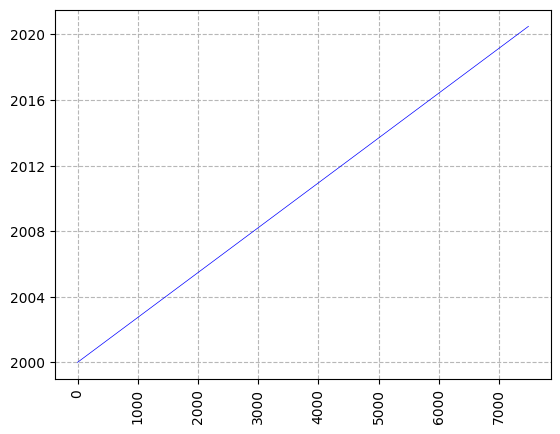

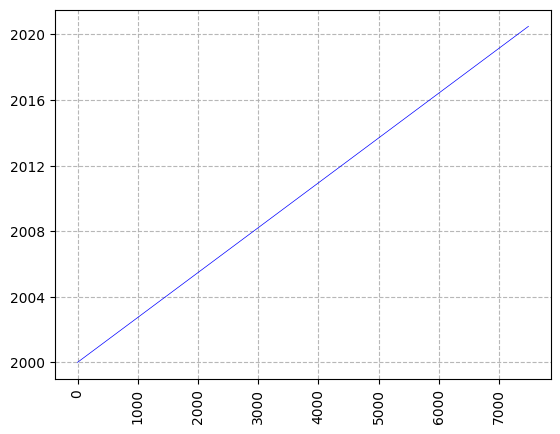

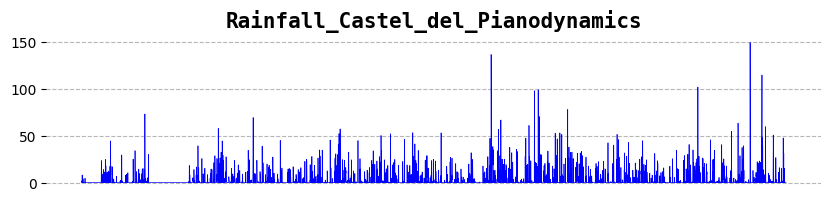

...

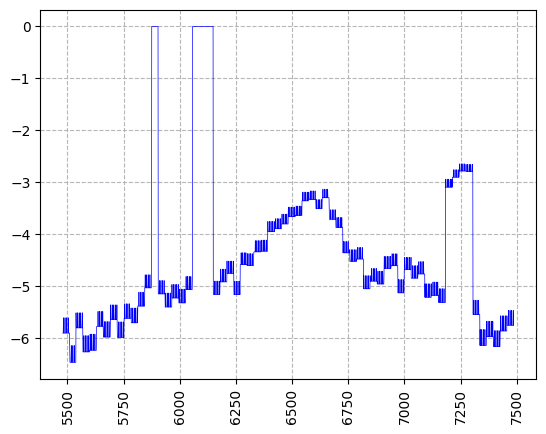

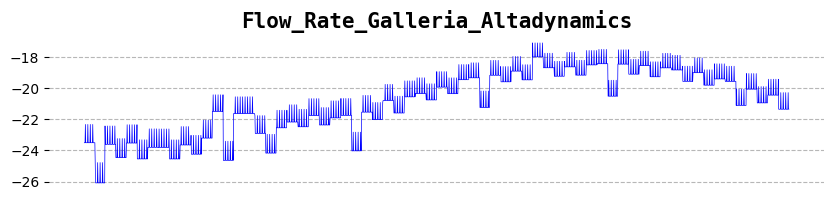

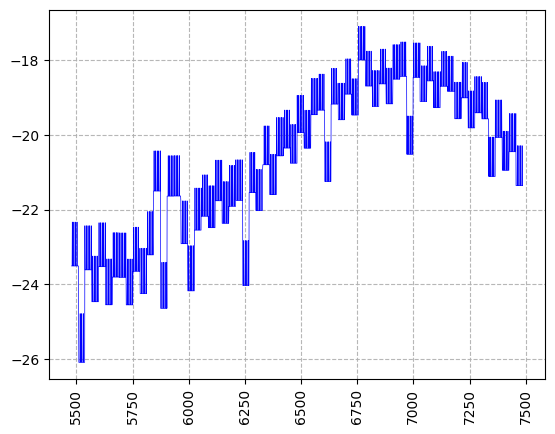

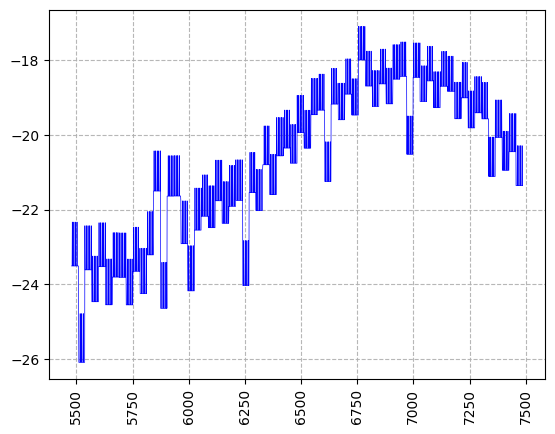

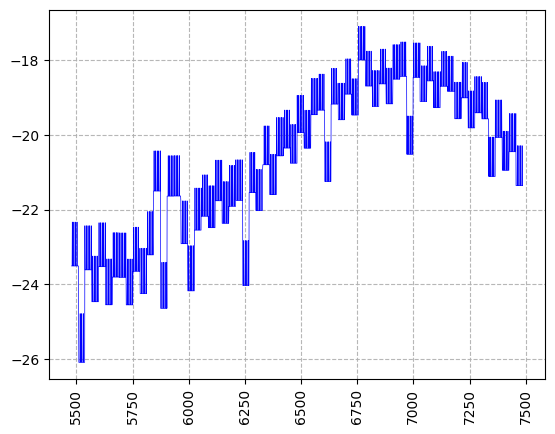

In [ ]:
columns_viz(ds[6],color='blue')

In [ ]:
amiata_pred= water_spring_amiata

amiata_pred['Date']=pd.to_datetime(amiata_pred['Date'])
amiata_pred=amiata_pred.set_index('Date')

rainfall_amiata=[col for col in amiata_pred.columns if 'Rainfall' in col]
temperature_amiata=[col for col in amiata_pred.columns if 'temperature' in col]

amiata_pred['rainfall_mean']=amiata_pred[rainfall_amiata].mean(axis=1).values
amiata_pred['temperature_mean']=amiata_pred[temperature_amiata].mean(axis=1).values
amiata_pred=amiata_pred.drop(['Depth_to_Groundwater_S_Fiora_8', 'Depth_to_Groundwater_S_Fiora_11bis',
                          'Rainfall_S_Fiora', 'Rainfall_Vetta_Amiata'],axis =1 )

amiata_Pred=amiata_pred.interpolate()

amiata_pred=amiata_pred.reset_index()
amiata_pred['Year']=amiata_pred['Date'].dt.year
amiata_pred['Month']=amiata_pred['Date'].dt.month
amiata_pred['Day']=amiata_pred['Date'].dt.day 
amiata_pred= amiata_pred.drop('Date', axis=1)

In [ ]:
targets=['Flow_Rate_Bugnano', 'Flow_Rate_Arbure', 'Flow_Rate_Ermicciolo', 'Flow_Rate_Galleria_Alta']
y6=amiata_pred[targets]
x6=amiata_pred.drop(targets,axis=1)

x_train_amiata,x_test_amiata,y_train_amiata,y_test_amiata=train_test_split(x6,y6,test_size=0.2,random_state=42,shuffle=False)

x_test_amiata=x_test_amiata[y_test_amiata.notna().all(axis=1)]
y_test_amiata=y_test_amiata.dropna()

y_train_amiata=y_train_amiata.fillna(method='bfill')



/tmp/ipykernel_546/3699944982.py:10: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y_train_amiata=y_train_amiata.fillna(method='bfill')


In [ ]:
params_amiata={'n_estimators': 200,
            'max_depth': 2,
            'subsample': 1,
            'learning_rate': 0.04,
            'random_state': 0,
            'enable_categorical': True}


amiata_model_Bugnano=XGBRegressor(**params_amiata)
amiata_model_Arbure=XGBRegressor(**params_amiata)
amiata_model_Ermicciolo=XGBRegressor(**params_amiata)
amiata_model_Galleria_Alta=XGBRegressor(**params_amiata)

amiata_model_Bugnano.fit(x_train_amiata,y_train_amiata['Flow_Rate_Bugnano'])
amiata_model_Arbure.fit(x_train_amiata,y_train_amiata['Flow_Rate_Arbure'])
amiata_model_Ermicciolo.fit(x_train_amiata,y_train_amiata['Flow_Rate_Ermicciolo'])
amiata_model_Galleria_Alta.fit(x_train_amiata,y_train_amiata['Flow_Rate_Galleria_Alta'])


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=True, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.04, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=2, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [ ]:
amiata_pred_Bugnano=amiata_model_Bugnano.predict(x_test_amiata)
amiata_pred_Arbure=amiata_model_Arbure.predict(x_test_amiata)
amiata_pred_Ermicciolo=amiata_model_Ermicciolo.predict(x_test_amiata)
amiata_pred_Galleria_Alta=amiata_model_Galleria_Alta.predict(x_test_amiata)

print('MAE value (Flow_Rate_Bugnano): ', mean_absolute_error(y_test_amiata['Flow_Rate_Bugnano'], amiata_pred_Bugnano))
print('MAE value (Flow_Rate_Arbure): ', mean_absolute_error(y_test_amiata['Flow_Rate_Arbure'], amiata_pred_Arbure))
print('MAE value (Flow_Rate_Ermicciolo): ', mean_absolute_error(y_test_amiata['Flow_Rate_Ermicciolo'], amiata_pred_Ermicciolo))
print('MAE value (Flow_Rate_Galleria_Alta): ', mean_absolute_error(y_test_amiata['Flow_Rate_Galleria_Alta'], amiata_pred_Galleria_Alta))



MAE value (Flow_Rate_Bugnano):  0.09868705353288064
MAE value (Flow_Rate_Arbure):  0.9284690377640856
MAE value (Flow_Rate_Ermicciolo):  1.427322599723309
MAE value (Flow_Rate_Galleria_Alta):  2.2769190843720044


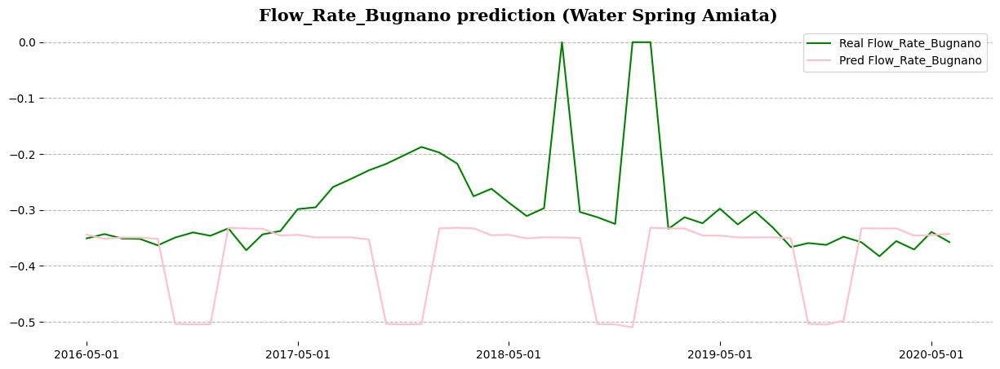

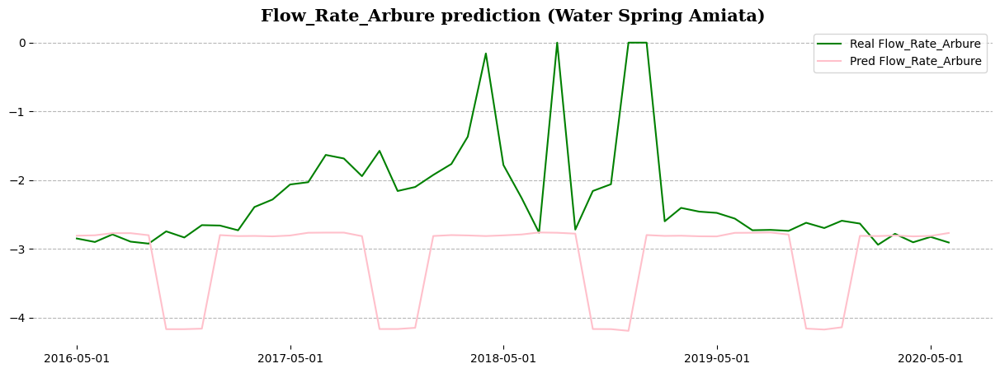

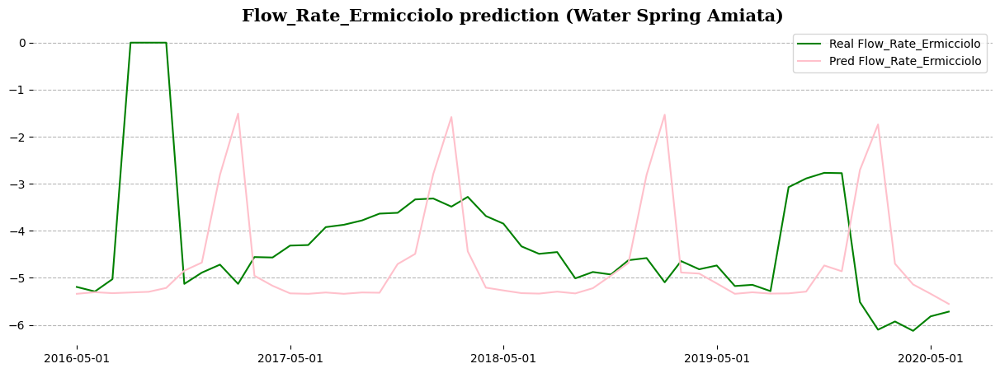

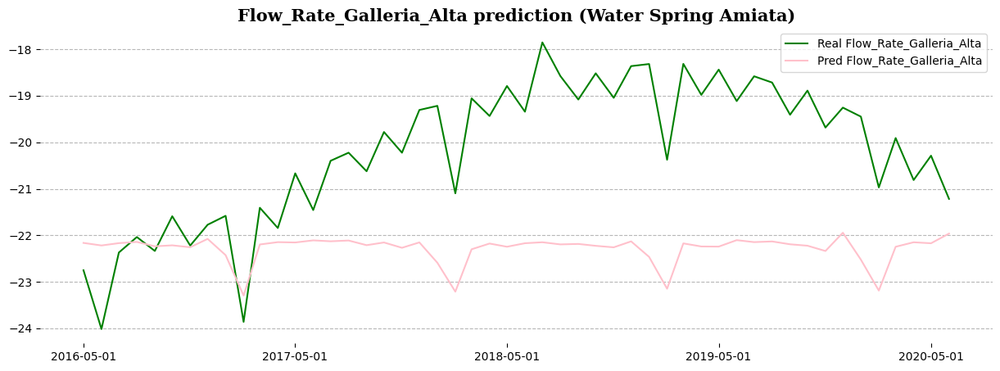

In [ ]:
predicted_viz(y_test_amiata['Flow_Rate_Bugnano'], amiata_pred_Bugnano, 'Flow_Rate_Bugnano', 'Water Spring Amiata', water_spring_amiata)
predicted_viz(y_test_amiata['Flow_Rate_Arbure'], amiata_pred_Arbure, 'Flow_Rate_Arbure', 'Water Spring Amiata', water_spring_amiata)
predicted_viz(y_test_amiata['Flow_Rate_Ermicciolo'], amiata_pred_Ermicciolo, 'Flow_Rate_Ermicciolo', 'Water Spring Amiata', water_spring_amiata)
predicted_viz(y_test_amiata['Flow_Rate_Galleria_Alta'], amiata_pred_Galleria_Alta, 'Flow_Rate_Galleria_Alta', 'Water Spring Amiata', water_spring_amiata)


Water Spring Lupa

In [51]:
ds[7].head()


,Date,Rainfall_Terni,Flow_Rate_Lupa
0,01/01/2009,2.797,NaN
1,02/01/2009,2.797,NaN
2,03/01/2009,2.797,NaN
3,04/01/2009,2.797,NaN
4,05/01/2009,2.797,NaN


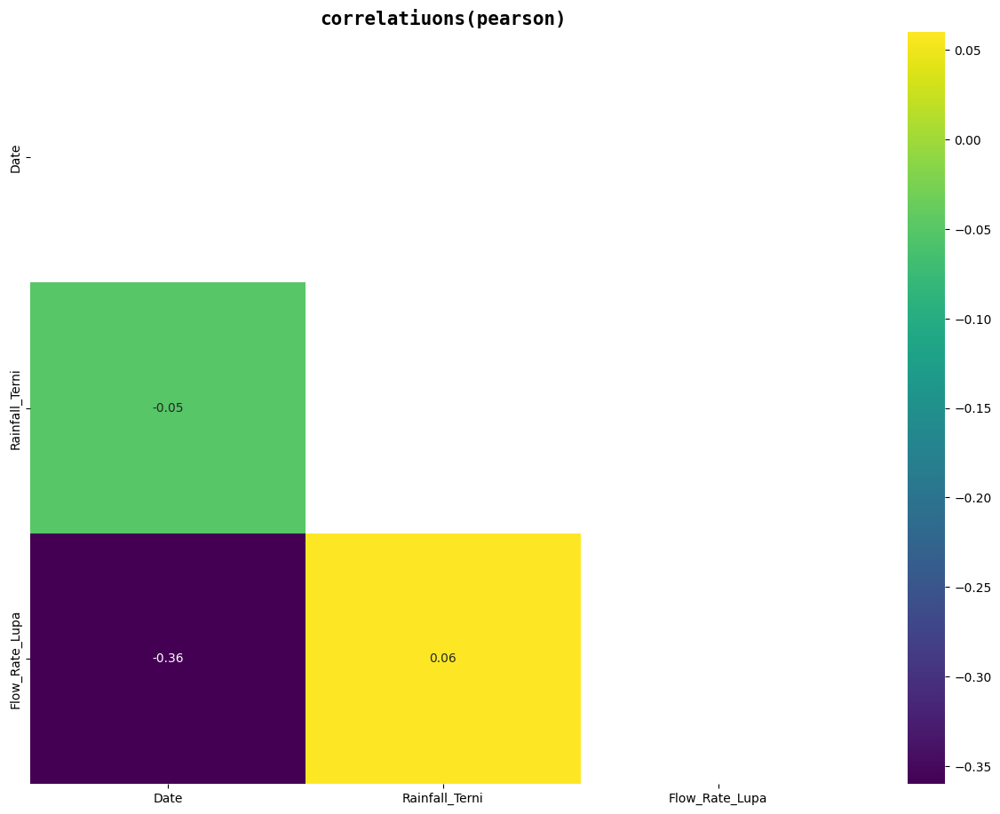

In [53]:
ds[7]['Date']=pd.to_datetime(ds[7]['Date'],dayfirst=True)
corr_plot(ds[7],'Water Spring Lupa',(20,20))


In [1]:
columns_viz(ds)

NameError: name 'columns_viz' is not defined

In [ ]:
ds[7]['Date'] = pd.to_datetime(ds[7]['Date'], dayfirst=True)
corr_plot(ds[7], 'Water Spring Lupa', (20, 20))

In [ ]:

columns_viz(datasets[7], color= 'blue')



In [ ]:
water_spring_lupa.columns


In [ ]:
lupa_pred = water_spring_lupa

lupa_pred['Date'] = pd.to_datetime(lupa_pred['Date'])
lupa_pred = lupa_pred.set_index('Date')

lupa_pred = lupa_pred.fillna(lupa_pred.interpolate())

lupa_pred = lupa_pred.reset_index()
lupa_pred['Year'] = lupa_pred['Date'].dt.year
lupa_pred['Month'] = lupa_pred['Date'].dt.month
lupa_pred['Day'] = lupa_pred['Date'].dt.day
lupa_pred = lupa_pred.drop('Date', axis=1)

In [ ]:
y7 = lupa_pred[['Flow_Rate_Lupa']]
y7_filled = y7.fillna(y7.median())
x7 = lupa_pred.drop(['Flow_Rate_Lupa'], axis = 1)

x_train_lupa_filled, x_test_lupa_filled, y_train_lupa_filled, y_test_lupa_filled = train_test_split(x7, y7_filled, test_size=0.2, random_state=42, shuffle=False)


In [ ]:
lupa_params = {'n_estimators': 200,
            'max_depth': 2,
            'subsample': 1,
            'learning_rate': 0.04,
            'random_state': 0,
            'enable_categorical': True}

lupa_model = XGBRegressor(**lupa_params)

lupa_model.fit(x_train_lupa_filled, y_train_lupa_filled)

In [ ]:
lupa_y_pred = lupa_model.predict(x_test_lupa_filled)

print('MAE value: ', mean_absolute_error(y_test_lupa_filled, lupa_y_pred))

In [ ]:
predicted_viz(y_test_lupa_filled, lupa_y_pred, 'Flow_Rate_Lupa', 'Water Spring Lupa', water_spring_lupa)


Water Spring Madonna

